In [1]:
import pandas as pd
import numpy as np
import pickle
import weighted_sentiment_functions_final as wsff
import stock_price_calculation_trials as spct
from datetime import datetime
from tqdm import tqdm

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Kevin\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
# To do: Nothing

In [3]:
all_data = pd.read_csv('final_all_mdna_data.csv', sep='.@', header=None, names=['DELETE', 'CIK', 'TICKER', 'DATE', 'TEXT'], dtype={'CIK': object}, engine='python', parse_dates=[3], infer_datetime_format=True, encoding='utf-8')
all_data

,DELETE,CIK,TICKER,DATE,TEXT
0,NaN,0000002488,AMD,2019-02-08,Our 2018 financial results demonstrate the suc...
1,NaN,0000002488,AMD,2018-02-27,2017 was an important year for AMD as we launc...
2,NaN,0000002488,AMD,2017-02-21,As we continued to focus on our strategy to im...
3,NaN,0000002488,AMD,2016-02-18,We faced a challenging business environment in...
4,NaN,0000002488,AMD,2015-02-19,"Net revenue for 2014 was $5.5 billion, an incr..."
...,...,...,...,...,...
233,NaN,0000766704,WELL,2009-03-02,"Health Care REIT, Inc., an S&P 500 company, is..."
234,NaN,0000766704,WELL,2008-02-28,"Health Care REIT, Inc. is an equity real esta..."
235,NaN,0000766704,WELL,2007-03-01,"Health Care REIT, Inc. is a self-administered,..."
236,NaN,0000766704,WELL,2006-03-10,"Health Care REIT, Inc. is a self-administered,..."


In [4]:
new_all_data = all_data.drop(['DELETE'], axis=1)
new_all_data

,CIK,TICKER,DATE,TEXT
0,0000002488,AMD,2019-02-08,Our 2018 financial results demonstrate the suc...
1,0000002488,AMD,2018-02-27,2017 was an important year for AMD as we launc...
2,0000002488,AMD,2017-02-21,As we continued to focus on our strategy to im...
3,0000002488,AMD,2016-02-18,We faced a challenging business environment in...
4,0000002488,AMD,2015-02-19,"Net revenue for 2014 was $5.5 billion, an incr..."
...,...,...,...,...
233,0000766704,WELL,2009-03-02,"Health Care REIT, Inc., an S&P 500 company, is..."
234,0000766704,WELL,2008-02-28,"Health Care REIT, Inc. is an equity real esta..."
235,0000766704,WELL,2007-03-01,"Health Care REIT, Inc. is a self-administered,..."
236,0000766704,WELL,2006-03-10,"Health Care REIT, Inc. is a self-administered,..."


In [5]:
# Check dataframe for any missing values:
# new_all_data.isnull().values.any()
# new_all_data.isnull().sum().sum()

In [6]:
# Comment/Uncomment following 4 lines to retrain the classifier
# All BoW models using class_weights=balanced

rf_bow_model, rf_vocab_dict = wsff.train_classifier(classifier_model='Random_Forest')
# save the model and vocab to disk
filename_rf = './models_and_dataframes/rb_bow_model.sav'
pickle.dump(rf_bow_model, open(filename_rf, 'wb'))

with open('./models_and_dataframes/rf_vocab_map.pkl', 'wb') as f:
    pickle.dump(rf_vocab_dict, f)
    
    
nb_bow_model, nb_vocab_dict = wsff.train_classifier(classifier_model='Naive_Bayes')

filename_nb = './models_and_dataframes/nb_bow_model.sav'
pickle.dump(nb_bow_model, open(filename_nb, 'wb'))

with open('./models_and_dataframes/nb_vocab_map.pkl', 'wb') as f:
    pickle.dump(nb_vocab_dict, f)

In [7]:
# load the trained classifier model and vocab from disk
filename_rf = './models_and_dataframes/rb_bow_model.sav'
rf_bow_model = pickle.load(open(filename_rf, 'rb'))

with open('./models_and_dataframes/rf_vocab_map.pkl', 'rb') as f:
    rf_vocab_dict = pickle.load(f)
    
    
filename_nb = './models_and_dataframes/nb_bow_model.sav'
nb_bow_model = pickle.load(open(filename_nb, 'rb'))

with open('./models_and_dataframes/nb_vocab_map.pkl', 'rb') as f:
    nb_vocab_dict = pickle.load(f)

In [8]:
# Comment/Uncomment following 4 lines to retrain the classifier for emebddings
rf_SBERT_bal_wiki = wsff.train_classifier_embeddings(classifier_model='Random_Forest', balanced=True, embedder='Wiki')
# filename = './models_and_dataframes/rf_SBERT_bal_wiki.sav'
# pickle.dump(rf_SBERT_bal_wiki, open(filename, 'wb'))
with open('./models_and_dataframes/rf_SBERT_bal_wiki.sav', 'wb') as f:
    pickle.dump(rf_SBERT_bal_wiki, f)

rf_SBERT_unbal_wiki = wsff.train_classifier_embeddings(classifier_model='Random_Forest', balanced=False, embedder='Wiki')
with open('./models_and_dataframes/rf_SBERT_unbal_wiki.sav', 'wb') as f:
    pickle.dump(rf_SBERT_unbal_wiki, f)

rf_SBERT_bal_NLI = wsff.train_classifier_embeddings(classifier_model='Random_Forest', balanced=True, embedder='NLI')
with open('./models_and_dataframes/rf_SBERT_bal_NLI.sav', 'wb') as f:
    pickle.dump(rf_SBERT_bal_NLI, f)

svm_SBERT_bal_wiki = wsff.train_classifier_embeddings(classifier_model='SVM', balanced=True, embedder='Wiki')
with open('./models_and_dataframes/svm_SBERT_bal_wiki.sav', 'wb') as f:
    pickle.dump(svm_SBERT_bal_wiki, f)

svm_SBERT_bal_NLI = wsff.train_classifier_embeddings(classifier_model='SVM', balanced=True, embedder='NLI')
with open('./models_and_dataframes/svm_SBERT_bal_NLI.sav', 'wb') as f:
    pickle.dump(svm_SBERT_bal_NLI, f)



In [9]:
# load the trained classifier model for SBERT method from disk

# filename = 'finalised_classifier_model_embeddings.sav'
# model_embeddings = pickle.load(open(filename, 'rb'))

with open('./models_and_dataframes/rf_SBERT_bal_wiki.sav', 'rb') as f:
    rf_SBERT_bal_wiki = pickle.load(f)
    
with open('./models_and_dataframes/rf_SBERT_unbal_wiki.sav', 'rb') as f:
    rf_SBERT_unbal_wiki = pickle.load(f)

with open('./models_and_dataframes/rf_SBERT_bal_NLI.sav', 'rb') as f:
    rf_SBERT_bal_NLI = pickle.load(f)
    
with open('./models_and_dataframes/svm_SBERT_bal_wiki.sav', 'rb') as f:
    svm_SBERT_bal_wiki = pickle.load(f)

with open('./models_and_dataframes/svm_SBERT_bal_NLI.sav', 'rb') as f:
    svm_SBERT_bal_NLI = pickle.load(f)

To-do: Might need to modify this, instead round each value maybe?
In regular sent analysis you get 0, 0.5, 1. With averaging justifications you get between 0 and 1, i.e. scaled/weighted.
Below is more like weighted mode aggregated. Whereas above 'weighted' function is like weighted mean aggregated.
But mode doesn't make much sense because it gets rid of the weight, so it is more like checking if 5 mined justifications can
capture the full sentiment of the entire document.
Read what you wrote in your thesis and then clarify all these sentiment score terms below!!!!!!

In [10]:
all_sentiments_list = []
mined_sentiments_list = []
full_sentiments_list = []

In [11]:
def calculate_mined_sentiments(actual_column_name, vocab, model, clustering_model, numericiser, embedder, aggregation):
    df_column_name = []
    for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
        sentiment = wsff.get_mined_sentiment(row['TEXT'], vocab, model, clustering_model=clustering_model, numericiser=numericiser, embedder=embedder, aggregation=aggregation)
        df_column_name.append(sentiment)
    print(actual_column_name, df_column_name)
    new_all_data[actual_column_name] = df_column_name
    all_sentiments_list.append(actual_column_name)
    mined_sentiments_list.append(actual_column_name)

In [12]:
def calculate_full_sentiments(actual_column_name, vocab, model, numericiser, embedder, aggregation):
    df_column_name = []
    for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
        sentiment = wsff.get_full_sentiment(row['TEXT'], vocab, model, numericiser=numericiser, embedder=embedder, aggregation=aggregation)
        df_column_name.append(sentiment)
    print(actual_column_name, df_column_name)
    new_all_data[actual_column_name] = df_column_name
    all_sentiments_list.append(actual_column_name)
    full_sentiments_list.append(actual_column_name)

In [13]:
# Random forests, BoW, Wiki embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_mean_agglo', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_meanr_agglo', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_mode_agglo', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_mean_dbscan', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_meanr_dbscan', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_mode_dbscan', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_mean_kmeans', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Kmeans', numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_bow_wiki_mined_mean_meanshift', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='MeanShift', numericiser='BoW', embedder='Wiki', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='rf_bow_wiki_full_mean', vocab=rf_vocab_dict, model=rf_bow_model, numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_full_sentiments(actual_column_name='rf_bow_wiki_full_meanr', vocab=rf_vocab_dict, model=rf_bow_model, numericiser='BoW', embedder='Wiki', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='rf_bow_wiki_full_mode', vocab=rf_vocab_dict, model=rf_bow_model, numericiser='BoW', embedder='Wiki', aggregation='Mode')


Getting sentiment scores: 238Filings [09:16,  2.34s/Filings]


rf_bow_wiki_mined_mean_agglo [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.25, 0.0, 0.0, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, -0

Getting sentiment scores: 238Filings [09:12,  2.32s/Filings]


rf_bow_wiki_mined_meanr_agglo [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Getting sentiment scores: 238Filings [09:12,  2.32s/Filings]


rf_bow_wiki_mined_mode_agglo [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [09:16,  2.34s/Filings]


rf_bow_wiki_mined_mean_dbscan [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.5, 0.40000000000000002, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.5, 

Getting sentiment scores: 238Filings [09:15,  2.33s/Filings]


rf_bow_wiki_mined_meanr_dbscan [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.

Getting sentiment scores: 238Filings [09:11,  2.32s/Filings]


rf_bow_wiki_mined_mode_dbscan [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [09:17,  2.34s/Filings]


rf_bow_wiki_mined_mean_kmeans [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.40000000000000002, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.25, 0.0, 0.0, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, -0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.4000000000000000

Getting sentiment scores: 238Filings [09:31,  2.40s/Filings]


rf_bow_wiki_mined_mean_meanshift [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.16666666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.5, -0.5, 0.0, -0.20000000000000001, 0.0, 0.0, -0.25, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.5, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.25, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Getting sentiment scores: 238Filings [00:04, 51.84Filings/s]


rf_bow_wiki_full_mean [0.071428571428571425, -0.038461538461538464, 0.021276595744680851, 0.0, -0.045454545454545456, 0.0, 0.02564102564102564, 0.086956521739130432, 0.0, 0.054054054054054057, 0.1111111111111111, 0.07407407407407407, 0.0, 0.22580645161290322, 0.0, 0.0, 0.027027027027027029, 0.027027027027027029, 0.027777777777777776, 0.026315789473684209, 0.0, 0.0, 0.0, 0.027027027027027029, 0.027027027027027029, 0.026315789473684209, 0.025000000000000001, 0.024390243902439025, 0.073170731707317069, 0.026315789473684209, 0.1111111111111111, 0.03125, 0.027777777777777776, 0.032258064516129031, 0.029411764705882353, 0.0, 0.0, -0.04878048780487805, 0.0, 0.066666666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.12903225806451613, -0.030303030303030304, 0.064516129032258063, 0.03125, 0.0, 0.0, 0.0, 0.0, 0.090909090909090912, 0.034482758620689655, -0.032258064516129031, 0.0, 0.125, 0.076923076923076927, 0.13333333333333333, 0.066666666666666666, 0.0, 0.0, 0.0, 

Getting sentiment scores: 238Filings [00:04, 50.62Filings/s]


rf_bow_wiki_full_meanr [0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

Getting sentiment scores: 238Filings [00:04, 51.42Filings/s]


rf_bow_wiki_full_mode [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [14]:
# random forests, BoW, NLI embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_mean_agglo', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_meanr_agglo', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='NLI', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_mode_agglo', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='NLI', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_mean_dbscan', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_meanr_dbscan', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='NLI', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_mode_dbscan', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='NLI', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_mean_kmeans', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='Kmeans', numericiser='BoW', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_bow_nli_mined_mean_meanshift', vocab=rf_vocab_dict, model=rf_bow_model, clustering_model='MeanShift', numericiser='BoW', embedder='NLI', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='rf_bow_nli_full_mean', vocab=rf_vocab_dict, model=rf_bow_model, numericiser='BoW', embedder='NLI', aggregation='Mean')
calculate_full_sentiments(actual_column_name='rf_bow_nli_full_meanr', vocab=rf_vocab_dict, model=rf_bow_model, numericiser='BoW', embedder='NLI', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='rf_bow_nli_full_mode', vocab=rf_vocab_dict, model=rf_bow_model, numericiser='BoW', embedder='NLI', aggregation='Mode')


Getting sentiment scores: 238Filings [09:13,  2.32s/Filings]


rf_bow_nli_mined_mean_agglo [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, -0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.40000000000000002, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.2000000000000

Getting sentiment scores: 238Filings [09:13,  2.32s/Filings]


rf_bow_nli_mined_meanr_agglo [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Getting sentiment scores: 238Filings [09:14,  2.33s/Filings]


rf_bow_nli_mined_mode_agglo [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [09:15,  2.33s/Filings]


rf_bow_nli_mined_mean_dbscan [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 

Getting sentiment scores: 238Filings [09:14,  2.33s/Filings]


rf_bow_nli_mined_meanr_dbscan [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0,

Getting sentiment scores: 238Filings [09:17,  2.34s/Filings]


rf_bow_nli_mined_mode_dbscan [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [09:21,  2.36s/Filings]


rf_bow_nli_mined_mean_kmeans [0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.25, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0,

Getting sentiment scores: 238Filings [09:34,  2.41s/Filings]


rf_bow_nli_mined_mean_meanshift [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Getting sentiment scores: 238Filings [00:05, 47.58Filings/s]


rf_bow_nli_full_mean [0.071428571428571425, -0.038461538461538464, 0.021276595744680851, 0.0, -0.045454545454545456, 0.0, 0.02564102564102564, 0.086956521739130432, 0.0, 0.054054054054054057, 0.1111111111111111, 0.07407407407407407, 0.0, 0.22580645161290322, 0.0, 0.0, 0.027027027027027029, 0.027027027027027029, 0.027777777777777776, 0.026315789473684209, 0.0, 0.0, 0.0, 0.027027027027027029, 0.027027027027027029, 0.026315789473684209, 0.025000000000000001, 0.024390243902439025, 0.073170731707317069, 0.026315789473684209, 0.1111111111111111, 0.03125, 0.027777777777777776, 0.032258064516129031, 0.029411764705882353, 0.0, 0.0, -0.04878048780487805, 0.0, 0.066666666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.12903225806451613, -0.030303030303030304, 0.064516129032258063, 0.03125, 0.0, 0.0, 0.0, 0.0, 0.090909090909090912, 0.034482758620689655, -0.032258064516129031, 0.0, 0.125, 0.076923076923076927, 0.13333333333333333, 0.066666666666666666, 0.0, 0.0, 0.0, 0

Getting sentiment scores: 238Filings [00:05, 47.59Filings/s]


rf_bow_nli_full_meanr [0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

Getting sentiment scores: 238Filings [00:04, 48.08Filings/s]


rf_bow_nli_full_mode [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [15]:
# Naive Bayes, BoW, Wiki embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_mean_agglo', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_meanr_agglo', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_mode_agglo', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='Agglomerative', numericiser='BoW', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_mean_dbscan', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_meanr_dbscan', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_mode_dbscan', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='DBSCAN', numericiser='BoW', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_mean_kmeans', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='Kmeans', numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='nb_bow_wiki_mined_mean_meanshift', vocab=nb_vocab_dict, model=nb_bow_model, clustering_model='MeanShift', numericiser='BoW', embedder='Wiki', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='nb_bow_wiki_full_mean', vocab=nb_vocab_dict, model=nb_bow_model, numericiser='BoW', embedder='Wiki', aggregation='Mean')
calculate_full_sentiments(actual_column_name='nb_bow_wiki_full_meanr', vocab=nb_vocab_dict, model=nb_bow_model, numericiser='BoW', embedder='Wiki', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='nb_bow_wiki_full_mode', vocab=nb_vocab_dict, model=nb_bow_model, numericiser='BoW', embedder='Wiki', aggregation='Mode')


Getting sentiment scores: 238Filings [09:09,  2.31s/Filings]


nb_bow_wiki_mined_mean_agglo [0.20000000000000001, 0.20000000000000001, 0.0, 0.0, -0.20000000000000001, -0.20000000000000001, -0.20000000000000001, 0.0, -0.59999999999999998, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, -0.40000000000000002, 0.59999999999999998, -0.20000000000000001, 0.0, -0.20000000000000001, -0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, -0.40000000000000002, 0.0, -0.20000000000000001, 0.0, -0.20000000000000001, 0.20000000000000001, 0.0, 0.25, 0.40000000000000002, 0.0, 0.0, 0.25, 0.0, 0.0, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, 0.0, -0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.40000000000000002, -0.20000000000000001, 0.25, -0.40000000000000002, -0.5, 0.20000000000000001, -0.25, 0.0, -0.25, 0.40000000000000002, -0.20000000000000001, 0.20000000000000001, 0.200000000000

Getting sentiment scores: 238Filings [09:11,  2.32s/Filings]


nb_bow_wiki_mined_meanr_agglo [0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 1.0, -0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -1.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -1.0, -0.0, -1.0, -0.0, 0.0, -0.0, 0.0, 0.0, 1.0, -0.0, -0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, -0.0,

Getting sentiment scores: 238Filings [09:10,  2.31s/Filings]


nb_bow_wiki_mined_mode_agglo [0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, -1, 1, -1, 0, -1, -1, -1, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, -1, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, -1, 0, 0, 0, -1, -1, 0, 0, 0, 0, -1, -1, -1, -1, 0, 0, 0, -1, 1, -1, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, -1, 1, -1, 1, -1, -1, -1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 1, -1, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1]


Getting sentiment scores: 238Filings [09:10,  2.31s/Filings]


nb_bow_wiki_mined_mean_dbscan [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 1.0, 1.0, -1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 1.0, 1.0, -1.0, -1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.5, 0.0, -0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, -1.0, 0.0, 1.0, -0.5, -1.0, 1.0, 0.0, 1.0, 0.33333333333333331, 0.33333333333333331, 0.0, 0.0, -0.5, 0.0, 0.0, 0.0, 0.33333333333333331, 0.5, 0.0, 0.0, -0.20000000000000001, -0.66666666666666663, 0.0, -0.5, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, -1.0, 0.0, 1.0, 0.0, 0.0, 1.0, -0.5

Getting sentiment scores: 238Filings [09:11,  2.32s/Filings]


nb_bow_wiki_mined_meanr_dbscan [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 1.0, 1.0, -1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 1.0, 1.0, -1.0, -1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, -1.0, 0.0, 1.0, -0.0, -1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -1.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 0.0, 0.0, 1.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0

Getting sentiment scores: 238Filings [09:11,  2.32s/Filings]


nb_bow_wiki_mined_mode_dbscan [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, -1, 0, 0, 1, 1, -1, 1, 0, 0, 0, 1, 1, 1, 1, 0, -1, 0, 0, 0, -1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 1, 1, -1, -1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, -1, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, -1, -1, 0, 1, -1, -1, 1, 0, 1, 0, 1, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, -1, 0, 0, 0, 0, 0, -1, 0, 1, 0, 0, 1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, -1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, -1, 1, 0, -1, 0, 1, 0, -1, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [09:16,  2.34s/Filings]


nb_bow_wiki_mined_mean_kmeans [0.20000000000000001, 0.0, 0.0, 0.20000000000000001, -0.40000000000000002, -0.40000000000000002, 0.0, 0.0, 0.0, 0.0, 0.40000000000000002, 0.0, 0.0, 0.0, 0.0, 0.40000000000000002, -0.20000000000000001, -0.40000000000000002, -0.40000000000000002, -0.40000000000000002, -0.40000000000000002, -0.59999999999999998, -0.20000000000000001, 0.20000000000000001, -0.40000000000000002, 0.0, 0.40000000000000002, -0.40000000000000002, -0.59999999999999998, -0.20000000000000001, 0.0, 0.0, 0.25, 0.40000000000000002, 0.25, 0.5, -0.25, -0.40000000000000002, -0.20000000000000001, -0.20000000000000001, 0.20000000000000001, 0.0, -0.40000000000000002, 0.0, 0.0, -0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, -0.20000000000000001, -0.25, 0.0, -0.5, 0.0, -0.25, -0.25, -0.5, 0.20000000000000001, -0.20000000000000001, 0.40000000000000002, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.4000000000000

Getting sentiment scores: 238Filings [09:29,  2.39s/Filings]


nb_bow_wiki_mined_mean_meanshift [0.20000000000000001, 0.25, 0.0, 0.25, 0.0, 0.0, -0.5, -0.33333333333333331, 0.0, 0.0, 0.0, 0.5, 0.33333333333333331, 0.33333333333333331, 0.25, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.5, 0.0, 0.0, 0.0, 0.66666666666666663, 1.0, 0.33333333333333331, 0.33333333333333331, -1.0, -0.33333333333333331, -0.33333333333333331, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.25, 0.0, -0.5, -0.66666666666666663, 0.0, 0.33333333333333331, 0.5, -0.5, -0.25, -0.25, 0.0, 0.0, 0.0, 0.0, 0.5, 0.33333333333333331, 0.0, -0.5, 0.25, 0.0, -0.33333333333333331, -1.0, 0.0, 1.0, 0.33333333333333331, 0.0, 0.5, 0.16666666666666666, -0.33333333333333331, 0.0, 0.0, -0.33333333333333331, -0.33333333333333331, 0.33333333333333331, -0.33333333333333331, 0.33333333333333331, -0.33333333333333331, -0.5, -0.5, -0.33333333333333331, -0.33333333333333331, -0.33333333333333331, -0.33333333333333331, -0.66666666666666663, 0

Getting sentiment scores: 238Filings [00:01, 120.77Filings/s]


nb_bow_wiki_full_mean [0.071428571428571425, 0.0, -0.10638297872340426, -0.12195121951219512, -0.045454545454545456, 0.058823529411764705, -0.05128205128205128, -0.086956521739130432, -0.22727272727272727, 0.16216216216216217, -0.1111111111111111, -0.037037037037037035, -0.14285714285714285, 0.0, -0.125, 0.33333333333333331, 0.027027027027027029, 0.027027027027027029, 0.027777777777777776, 0.0, 0.10526315789473684, 0.10810810810810811, 0.13513513513513514, 0.1891891891891892, 0.081081081081081086, 0.15789473684210525, 0.14999999999999999, 0.12195121951219512, 0.073170731707317069, 0.052631578947368418, 0.1111111111111111, 0.15625, 0.19444444444444445, 0.22580645161290322, 0.29411764705882354, 0.16666666666666666, 0.054054054054054057, -0.097560975609756101, -0.088235294117647065, 0.0, 0.10526315789473684, 0.0, 0.0, 0.090909090909090912, -0.045454545454545456, -0.045454545454545456, 0.086956521739130432, 0.076923076923076927, 0.07407407407407407, 0.0, 0.043478260869565216, 0.22727272727

Getting sentiment scores: 238Filings [00:01, 121.69Filings/s]


nb_bow_wiki_full_meanr [0.0, 0.0, -0.0, -0.0, -0.0, 0.0, -0.0, -0.0, -0.0, 0.0, -0.0, -0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, 0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, 0.

Getting sentiment scores: 238Filings [00:02, 115.90Filings/s]


nb_bow_wiki_full_mode [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [16]:
# Random forests, SBERT, balanced weights, Wiki embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_mean_agglo', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_meanr_agglo', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_mode_agglo', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_mean_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_meanr_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_mode_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_mean_kmeans', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='Kmeans', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_wiki_mined_mean_meanshift', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, clustering_model='MeanShift', numericiser='SBERT', embedder='Wiki', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='rf_SBERT_bal_wiki_full_mean', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_full_sentiments(actual_column_name='rf_SBERT_bal_wiki_full_meanr', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='rf_SBERT_bal_wiki_full_mode', vocab=rf_vocab_dict, model=rf_SBERT_bal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='Mode')


Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


rf_SBERT_bal_wiki_mined_mean_agglo [0.40000000000000002, 0.40000000000000002, 0.0, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, -0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, -0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.40000000000000002

Getting sentiment scores: 238Filings [17:12,  4.34s/Filings]


rf_SBERT_bal_wiki_mined_meanr_agglo [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0,

Getting sentiment scores: 238Filings [17:12,  4.34s/Filings]


rf_SBERT_bal_wiki_mined_mode_agglo [0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, -1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, -1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:14,  4.34s/Filings]


rf_SBERT_bal_wiki_mined_mean_dbscan [1.0, 0.0, 0.0, 0.5, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 1.0, 0.5, 0.0, 0.5, 0.5, 0.0, 0.5, 0.0, 0.0, -1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 1.0, 1.0, 1.0, 0.0, 0.33333333333333331, 1.0, 1.0, 0.66666666666666663, 1.0, 0.0, 1.0, 0.66666666666666663, 0.66666666666666663, 0.5, 1.0, 1.0, 0.80000000000000004, 0.66666666666666663, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, -1.0, 1.0

Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


rf_SBERT_bal_wiki_mined_meanr_dbscan [1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, -1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0

Getting sentiment scores: 238Filings [17:12,  4.34s/Filings]


rf_SBERT_bal_wiki_mined_mode_dbscan [1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, -1, -1, 1, 0, 1, 1, -1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, -1, 0, 1, 0, -1, 1, 1, 1, 0, 0, 1, 1, -1, -1, -1, -1, -1, 0, 1, -1, 1, -1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:20,  4.37s/Filings]


rf_SBERT_bal_wiki_mined_mean_kmeans [0.40000000000000002, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, -0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.40000000000000002, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.40000000000000002, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.2000000000

Getting sentiment scores: 238Filings [17:31,  4.42s/Filings]


rf_SBERT_bal_wiki_mined_mean_meanshift [0.20000000000000001, 0.25, 0.0, 0.0, 0.5, 0.5, 0.0, 0.0, 0.5, 1.0, 0.5, 0.5, 0.33333333333333331, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.33333333333333331, 0.33333333333333331, 0.0, 0.0, 0.5, 0.0, 0.25, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.25, 0.0, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.5, 0.5, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 1.0, -0.20000000000000001, -0.20000000000000001, 0.0, 0.5, 0.25, 0.14285714285714285, 0.14285714285714285, 0.6666666666666666

Getting sentiment scores: 238Filings [09:08,  2.30s/Filings]


rf_SBERT_bal_wiki_full_mean [0.2857142857142857, 0.22222222222222221, 0.13725490196078433, 0.023809523809523808, 0.18181818181818182, 0.17647058823529413, 0.0, 0.17391304347826086, 0.31818181818181818, 0.027027027027027029, -0.066666666666666666, 0.25925925925925924, 0.39285714285714285, 0.19354838709677419, 0.125, 0.16666666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.024390243902439025, 0.0, 0.083333333333333329, 0.0625, 0.10256410256410256, 0.03125, 0.13513513513513514, 0.10256410256410256, 0.11904761904761904, 0.13953488372093023, 0.10810810810810811, 0.09375, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.125, -0.085714285714285715, 0.058823529411764705, 0.054054054054054057, 0.0, 0.028571428571428571, -0.066666666666666666, 0.15789473684210525, 0.043478260869565216, -0.27586206896551724, 0.0, -0.030303030303030304, 0.0, 0.0, 0.13333333333333333, 0.26666666666666666, 0.27272727272727271, 0.13636363636363635, 0.1875, 0.14999999999999

Getting sentiment scores: 238Filings [09:07,  2.30s/Filings]


rf_SBERT_bal_wiki_full_meanr [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1

Getting sentiment scores: 238Filings [09:08,  2.31s/Filings]


rf_SBERT_bal_wiki_full_mode [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [17]:
# Random forests, SBERT, unbalanced weights, Wiki embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_mean_agglo', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_meanr_agglo', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_mode_agglo', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_mean_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_meanr_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_mode_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_mean_kmeans', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='Kmeans', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_unbal_wiki_mined_mean_meanshift', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, clustering_model='MeanShift', numericiser='SBERT', embedder='Wiki', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='rf_SBERT_unbal_wiki_full_mean', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_full_sentiments(actual_column_name='rf_SBERT_unbal_wiki_full_meanr', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='rf_SBERT_unbal_wiki_full_mode', vocab=rf_vocab_dict, model=rf_SBERT_unbal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='Mode')


Getting sentiment scores: 238Filings [17:16,  4.35s/Filings]


rf_SBERT_unbal_wiki_mined_mean_agglo [0.40000000000000002, 0.20000000000000001, 0.0, 0.20000000000000001, 0.59999999999999998, 0.20000000000000001, 0.59999999999999998, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, -0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.40000000000000002, 0.20000000000000001, 0.0, 0.20000000000000001, -0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001,

Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


rf_SBERT_unbal_wiki_mined_meanr_agglo [0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -0.0, 0.0, 1.0, -1.0, 0.0, -0.0, 0.0, -0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.

Getting sentiment scores: 238Filings [17:14,  4.35s/Filings]


rf_SBERT_unbal_wiki_mined_mode_agglo [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, -1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, -1, 0, -1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


rf_SBERT_unbal_wiki_mined_mean_dbscan [1.0, 0.0, 0.0, 0.5, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 1.0, 0.5, 0.0, 1.0, 0.5, 0.0, 0.5, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.66666666666666663, 1.0, 0.0, 1.0, 0.66666666666666663, 0.66666666666666663, 0.5, 1.0, 1.0, 0.80000000000000004, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, -1.0, 0.0, 1.0, 1.0, 0.0, -1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0,

Getting sentiment scores: 238Filings [17:14,  4.34s/Filings]


rf_SBERT_unbal_wiki_mined_meanr_dbscan [1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, -1.0, 0.0, 1.0, 1.0, 0.0, -1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


rf_SBERT_unbal_wiki_mined_mode_dbscan [1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, -1, 0, 1, 1, -1, -1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, -1, 1, 1, 0, 1, 0, -1, 0, 1, 1, 0, 0, 1, 1, -1, -1, -1, -1, -1, 0, 1, -1, 1, -1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:21,  4.38s/Filings]


rf_SBERT_unbal_wiki_mined_mean_kmeans [0.40000000000000002, 0.20000000000000001, 0.0, -0.20000000000000001, 0.59999999999999998, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.40000000000000002, -0.20000000000000001, 0.40000000000000002, 0.0, 0.40000000000000002, -0.20000000000000001, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.2000000000

Getting sentiment scores: 238Filings [17:34,  4.43s/Filings]


rf_SBERT_unbal_wiki_mined_mean_meanshift [0.20000000000000001, 0.25, 0.0, 0.25, 0.5, 0.5, 0.0, 0.33333333333333331, 0.5, 1.0, 0.5, 0.5, 0.33333333333333331, 0.33333333333333331, 0.0, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.33333333333333331, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.33333333333333331, 0.0, 0.0, 0.25, 1.0, -0.66666666666666663, 0.0, 0.0, 0.0, 0.0, 0.5, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.5, 0.5, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 1.0, 0.40000000000000002, 0.40000000000000002, 0.0, 0.5, 0.5, 0.42857142857142855, 0.14285

Getting sentiment scores: 238Filings [09:08,  2.30s/Filings]


rf_SBERT_unbal_wiki_full_mean [0.35714285714285715, 0.14814814814814814, 0.11764705882352941, 0.023809523809523808, 0.27272727272727271, 0.29411764705882354, 0.076923076923076927, 0.2608695652173913, 0.31818181818181818, 0.35135135135135137, 0.0, 0.29629629629629628, 0.35714285714285715, 0.19354838709677419, 0.083333333333333329, 0.33333333333333331, -0.081081081081081086, -0.081081081081081086, -0.083333333333333329, -0.052631578947368418, -0.052631578947368418, -0.054054054054054057, -0.054054054054054057, -0.054054054054054057, -0.054054054054054057, 0.0, 0.0, 0.024390243902439025, 0.04878048780487805, 0.0, 0.083333333333333329, 0.0625, 0.02564102564102564, 0.125, 0.10810810810810811, 0.20512820512820512, 0.095238095238095233, 0.23255813953488372, 0.10810810810810811, 0.0625, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.09375, -0.028571428571428571, 0.058823529411764705, 0.081081081081081086, 0.04878048780487805, 0.057142857142857141, -0.066666666666666666, 0.

Getting sentiment scores: 238Filings [09:09,  2.31s/Filings]


rf_SBERT_unbal_wiki_full_meanr [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

Getting sentiment scores: 238Filings [09:09,  2.31s/Filings]


rf_SBERT_unbal_wiki_full_mode [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [18]:
# Random forests, SBERT, balanced weights, NLI embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_mean_agglo', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='Agglomerative', numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_meanr_agglo', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='Agglomerative', numericiser='SBERT', embedder='NLI', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_mode_agglo', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='Agglomerative', numericiser='SBERT', embedder='NLI', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_mean_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='DBSCAN', numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_meanr_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='DBSCAN', numericiser='SBERT', embedder='NLI', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_mode_dbscan', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='DBSCAN', numericiser='SBERT', embedder='NLI', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_mean_kmeans', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='Kmeans', numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='rf_SBERT_bal_nli_mined_mean_meanshift', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, clustering_model='MeanShift', numericiser='SBERT', embedder='NLI', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='rf_SBERT_bal_nli_full_mean', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_full_sentiments(actual_column_name='rf_SBERT_bal_nli_full_meanr', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, numericiser='SBERT', embedder='NLI', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='rf_SBERT_bal_nli_full_mode', vocab=rf_vocab_dict, model=rf_SBERT_bal_NLI, numericiser='SBERT', embedder='NLI', aggregation='Mode')


Getting sentiment scores: 238Filings [17:17,  4.36s/Filings]


rf_SBERT_bal_nli_mined_mean_agglo [0.40000000000000002, 0.20000000000000001, 0.20000000000000001, -0.40000000000000002, 0.0, 0.40000000000000002, -0.20000000000000001, 0.0, 0.40000000000000002, 0.0, -0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, 0.0, -0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.40000000000000002, 0.40000000000000002, 0.0, 0.0, 0.59999999999999998, 0.20000000000000001, -0.20000000000000001, 0.20000

Getting sentiment scores: 238Filings [17:19,  4.37s/Filings]


rf_SBERT_bal_nli_mined_meanr_agglo [0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0,

Getting sentiment scores: 238Filings [17:18,  4.36s/Filings]


rf_SBERT_bal_nli_mined_mode_agglo [0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, -1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, -1, 1, -1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, -1, 0, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, -1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, -1, 0, 0, 0, 0, 0, 0, -1, 1, 0, 0, 0, -1, 1, 1, 0, -1, 0, -1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:18,  4.36s/Filings]


rf_SBERT_bal_nli_mined_mean_dbscan [1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, -1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

Getting sentiment scores: 238Filings [17:19,  4.37s/Filings]


rf_SBERT_bal_nli_mined_meanr_dbscan [1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, -1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1

Getting sentiment scores: 238Filings [17:20,  4.37s/Filings]


rf_SBERT_bal_nli_mined_mode_dbscan [1, 0, 0, -1, 0, 0, 0, 1, 0, 0, -1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, -1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, -1, 0, 1, 1, 1, -1, 1, 1, 1, 1, -1, -1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, 1, 1, 0, -1, 1, 1, 0, 1, -1, 1, 1, -1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:25,  4.39s/Filings]


rf_SBERT_bal_nli_mined_mean_kmeans [0.40000000000000002, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, 0.0, 0.40000000000000002, -0.20000000000000001, 0.0, 0.40000000000000002, 0.0, -0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.40000000000000002, 0.40000000000000002, 0.0, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, -0.20000000000000001, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.0, 0.40000000000000002, 0.40000000000000002, 0.0, 0.40

Getting sentiment scores: 238Filings [17:39,  4.45s/Filings]


rf_SBERT_bal_nli_mined_mean_meanshift [0.5, 0.0, 0.0, -1.0, 0.0, 0.5, 0.0, 0.33333333333333331, 0.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 0.5, 0.5, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.33333333333333331, 0.33333333333333331, 0.33333333333333331, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.33333333333333331, 0.0, 0.0, 0.5, 0.0, 0.5, 0.5, 0.5, 0.33333333333333331, -0.25, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.40000000000000002, -0.20000000000000001, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.5, 0.5, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.5, 1.0, 0.0, 1.0, 0.5, 0.25, 0.33333333333333331, 0.33333333333333331, 0.0, 0.0, 1.0, 0.25, 0.25, 0.0, 0.0, 0.0, 1.0, -1.0, 0.5, 0.0, 0.0, 0.0, 0.0, 1.0, 0.5, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.25, 0.33333333333333331, 0.16666666666666666, 0.20000000000000001, 1.0, 0.20000000000000001, 0.25, 0.75, 0.0, -0.

Getting sentiment scores: 238Filings [09:12,  2.32s/Filings]


rf_SBERT_bal_nli_full_mean [0.5, 0.25925925925925924, 0.11764705882352941, -0.21428571428571427, 0.045454545454545456, 0.17647058823529413, -0.10256410256410256, 0.21739130434782608, 0.13636363636363635, 0.0, -0.17777777777777778, 0.22222222222222221, 0.25, 0.22580645161290322, 0.083333333333333329, 0.27777777777777779, 0.21621621621621623, 0.21621621621621623, 0.19444444444444445, 0.21052631578947367, 0.18421052631578946, 0.16216216216216217, 0.1891891891891892, 0.1891891891891892, 0.13513513513513514, 0.10526315789473684, 0.14999999999999999, 0.097560975609756101, 0.073170731707317069, 0.13157894736842105, 0.27777777777777779, 0.25, 0.23076923076923078, 0.03125, 0.21621621621621623, 0.30769230769230771, 0.30952380952380953, 0.37209302325581395, 0.1891891891891892, 0.0625, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0625, -0.028571428571428571, 0.029411764705882353, -0.054054054054054057, 0.04878048780487805, -0.085714285714285715, 0.066666666666666666, 0.05263

Getting sentiment scores: 238Filings [09:10,  2.31s/Filings]


rf_SBERT_bal_nli_full_meanr [0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, -0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 

Getting sentiment scores: 238Filings [09:11,  2.32s/Filings]


rf_SBERT_bal_nli_full_mode [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, -1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [19]:
# SVM, SBERT, balanced weights, Wiki embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_mean_agglo', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_meanr_agglo', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_mode_agglo', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='Agglomerative', numericiser='SBERT', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_mean_dbscan', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_meanr_dbscan', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_mode_dbscan', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='DBSCAN', numericiser='SBERT', embedder='Wiki', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_mean_kmeans', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='Kmeans', numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_wiki_mined_mean_meanshift', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, clustering_model='MeanShift', numericiser='SBERT', embedder='Wiki', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='svm_SBERT_bal_wiki_full_mean', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='Mean')
calculate_full_sentiments(actual_column_name='svm_SBERT_bal_wiki_full_meanr', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='svm_SBERT_bal_wiki_full_mode', vocab=rf_vocab_dict, model=svm_SBERT_bal_wiki, numericiser='SBERT', embedder='Wiki', aggregation='Mode')


Getting sentiment scores: 238Filings [17:16,  4.35s/Filings]


svm_SBERT_bal_wiki_mined_mean_agglo [1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

Getting sentiment scores: 238Filings [17:16,  4.36s/Filings]


svm_SBERT_bal_wiki_mined_meanr_agglo [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

Getting sentiment scores: 238Filings [17:18,  4.36s/Filings]


svm_SBERT_bal_wiki_mined_mode_agglo [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


svm_SBERT_bal_wiki_mined_mean_dbscan [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

Getting sentiment scores: 238Filings [17:13,  4.34s/Filings]


svm_SBERT_bal_wiki_mined_meanr_dbscan [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1

Getting sentiment scores: 238Filings [17:14,  4.35s/Filings]


svm_SBERT_bal_wiki_mined_mode_dbscan [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


Getting sentiment scores: 238Filings [18:13,  4.60s/Filings]


svm_SBERT_bal_wiki_mined_mean_kmeans [1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 0.80000000000000004, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 0.80000000000000004, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

Getting sentiment scores: 238Filings [17:39,  4.45s/Filings]


svm_SBERT_bal_wiki_mined_mean_meanshift [1.0, 1.0, 1.0, 0.75, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.66666666666666663, 0.66666666666666663, 0.75, 0.66666666666666663, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 0.66666666666666663, 0.66666666666666663, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.66666666666666663, 0.66666666666666663, 0.66666666666666663, 0.66666666666666663, 0.66666666666666663, 0.66666666666666663, 0.66666666666666663, 0.66666666666666663, 0.5, 0.5, 1.0, 1.0, 0.75, 0.66666666666666663, 0.66666666666666663, 1.0, 1.0, 1.0, 0.75, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.83333333333333337, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.5, 0.66666666666666663, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.5, 0.66666666666666663, 0.66666666666666663, 0.5, 0.20000000000000001, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.83333333

Getting sentiment scores: 238Filings [09:47,  2.47s/Filings]


svm_SBERT_bal_wiki_full_mean [1.0, 1.0, 1.0, 0.97619047619047616, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9642857142857143, 0.967741935483871, 0.95833333333333337, 0.94444444444444442, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.97560975609756095, 1.0, 1.0, 1.0, 1.0, 1.0, 0.96875, 0.97297297297297303, 1.0, 1.0, 1.0, 1.0, 1.0, 0.94999999999999996, 1.0, 1.0, 0.95454545454545459, 0.95454545454545459, 0.95454545454545459, 0.91666666666666663, 0.92592592592592593, 0.9285714285714286, 0.91304347826086951, 0.91666666666666663, 0.86956521739130432, 0.84615384615384615, 1.0, 1.0, 0.97058823529411764, 0.97297297297297303, 0.97560975609756095, 1.0, 1.0, 1.0, 0.95652173913043481, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.95652173913043481, 0.97435897435897434, 0.88, 1.0, 0.96969696969696972, 0.9285714285714286, 0.97058823529411764, 0.96153846153846156, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.97872340425531912, 0.97777777777777775, 0.98245614035087714, 1.0, 1.0,

Getting sentiment scores: 238Filings [09:49,  2.48s/Filings]


svm_SBERT_bal_wiki_full_meanr [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,

Getting sentiment scores: 238Filings [09:50,  2.48s/Filings]


svm_SBERT_bal_wiki_full_mode [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [20]:
# SVM, SBERT, balanced weights, NLI embeddings
# Mined:
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_mean_agglo', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='Agglomerative', numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_meanr_agglo', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='Agglomerative', numericiser='SBERT', embedder='NLI', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_mode_agglo', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='Agglomerative', numericiser='SBERT', embedder='NLI', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_mean_dbscan', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='DBSCAN', numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_meanr_dbscan', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='DBSCAN', numericiser='SBERT', embedder='NLI', aggregation='MeanRounded')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_mode_dbscan', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='DBSCAN', numericiser='SBERT', embedder='NLI', aggregation='Mode')

calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_mean_kmeans', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='Kmeans', numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_mined_sentiments(actual_column_name='svm_SBERT_bal_nli_mined_mean_meanshift', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, clustering_model='MeanShift', numericiser='SBERT', embedder='NLI', aggregation='Mean')

# Full:
calculate_full_sentiments(actual_column_name='svm_SBERT_bal_nli_full_mean', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, numericiser='SBERT', embedder='NLI', aggregation='Mean')
calculate_full_sentiments(actual_column_name='svm_SBERT_bal_nli_full_meanr', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, numericiser='SBERT', embedder='NLI', aggregation='MeanRounded')
calculate_full_sentiments(actual_column_name='svm_SBERT_bal_nli_full_mode', vocab=rf_vocab_dict, model=svm_SBERT_bal_NLI, numericiser='SBERT', embedder='NLI', aggregation='Mode')


Getting sentiment scores: 238Filings [17:22,  4.38s/Filings]


svm_SBERT_bal_nli_mined_mean_agglo [0.20000000000000001, 0.20000000000000001, 0.20000000000000001, -0.20000000000000001, 0.0, 0.80000000000000004, -0.40000000000000002, 0.20000000000000001, 0.40000000000000002, -0.20000000000000001, -0.20000000000000001, 0.40000000000000002, 0.20000000000000001, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.40000000000000002, 0.40000000000000002, 0.40000000000000002, 0.40000000000000002, 0.40000000000000002, 0.59999999999999998, 0.59999999999999998, 0.40000000000000002, 0.59999999999999998, 0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.20000000000000001, 0.20000000000000001, 0.59999999999999998, -0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.20000000000000001, 0.0, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.20000000000000001, 0.0, -0.40000000000000002, -0.40000000000000002, -0.20000000000000001, -0.40000000000000002, -0.40000000000000002, -0.40000000000000002, 0

Getting sentiment scores: 238Filings [17:20,  4.37s/Filings]


svm_SBERT_bal_nli_mined_meanr_agglo [0.0, 0.0, 0.0, -0.0, 0.0, 1.0, -0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, 0.0, -0.0, 0.0, -1.0, -0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, 0.0, 1.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0,

Getting sentiment scores: 238Filings [17:24,  4.39s/Filings]


svm_SBERT_bal_nli_mined_mode_agglo [0, 0, 0, -1, 0, 1, 0, 0, 0, -1, -1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, -1, 0, -1, -1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, -1, -1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, -1, 1, 0, 1, 1, 0, 0, 0, 0, 0, -1, -1, 1, -1, 0, 1, -1, -1, 0, 1, 1, 0, 1, -1, 0, 0, -1, 0, -1, -1, -1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, -1, -1, -1, 0, 0, 0, 1, 0, -1, 1, -1, 1, 1, -1, 1, 1, -1, -1, 1, -1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0]


Getting sentiment scores: 238Filings [17:21,  4.38s/Filings]


svm_SBERT_bal_nli_mined_mean_dbscan [1.0, 1.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, -1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, -1.0, 0.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, -1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, -1.0, -1.0, -1.0, 1.0, 1.0, -1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

Getting sentiment scores: 238Filings [17:19,  4.37s/Filings]


svm_SBERT_bal_nli_mined_meanr_dbscan [1.0, 1.0, 0.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, -1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, -1.0, 0.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, -1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, -1.0, -1.0, -1.0, 1.0, 1.0, -1.0, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

Getting sentiment scores: 238Filings [17:20,  4.37s/Filings]


svm_SBERT_bal_nli_mined_mode_dbscan [1, 1, 0, -1, 1, 1, 0, 1, 1, 1, -1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, -1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, 0, -1, -1, -1, 1, -1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, -1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, -1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, -1, 1, 1, 1, 1, -1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, -1, -1, 1, 1, 1, -1, 1, 1, 1, 1, -1, -1, 1, 1, 1, 1, -1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, -1, 1, 1, -1, -1, 1, 1, 1, 1, -1, 1, -1, -1, 1, -1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, -1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 1, 0]


Getting sentiment scores: 238Filings [17:31,  4.42s/Filings]


svm_SBERT_bal_nli_mined_mean_kmeans [0.20000000000000001, 0.0, 0.20000000000000001, 0.0, 0.0, 0.40000000000000002, -0.40000000000000002, 0.40000000000000002, 0.20000000000000001, -0.59999999999999998, -0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, -0.20000000000000001, 0.20000000000000001, 0.40000000000000002, 0.40000000000000002, 0.40000000000000002, 0.20000000000000001, 0.59999999999999998, 0.40000000000000002, 0.59999999999999998, 0.59999999999999998, 0.59999999999999998, 0.59999999999999998, 0.59999999999999998, 0.0, 0.20000000000000001, 0.0, 0.40000000000000002, 0.20000000000000001, 0.40000000000000002, -0.20000000000000001, 0.20000000000000001, 0.0, 0.0, 0.20000000000000001, -0.20000000000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.40000000000000002, -0.40000000000000002, -0.20000000000000001, -0.20000000000000001, -0.40000000000000002, 0.0, 0.0, -0.20000000000000001, -0.59999999999999998, -0.59999999999999998, -0.2000000

Getting sentiment scores: 238Filings [18:56,  4.78s/Filings]


svm_SBERT_bal_nli_mined_mean_meanshift [0.5, 0.5, 0.0, -1.0, 0.5, 0.5, 0.0, 0.66666666666666663, 1.0, 0.5, -1.0, 1.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 0.33333333333333331, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.33333333333333331, 0.0, -0.5, -1.0, -1.0, -1.0, 0.0, -0.33333333333333331, 0.5, -1.0, 0.5, -0.33333333333333331, 1.0, 0.0, 0.5, 0.33333333333333331, 0.5, 0.5, 0.5, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, -0.25, 0.20000000000000001, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.5, 0.5, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.5, 1.0, -1.0, 1.0, 0.5, 0.25, 0.33333333333333331, 0.33333333333333331, 0.0, 0.0, 1.0, 0.25, 0.25, 0.5, 0.0, 0.0, 1.0, -1.0, 0.5, 1.0, 1.0, 1.0, 0.0, 1.0, 0.5, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.25, 0.33333333333333331, 0.66666666666666663, 0.20000000000000001, 1.0, 0.20000000000000001, 0.25, 0.75, -0.25, -0.33333333333333331, 0.3

Getting sentiment scores: 238Filings [10:31,  2.65s/Filings]


svm_SBERT_bal_nli_full_mean [0.5, 0.40740740740740738, 0.15686274509803921, -0.11904761904761904, 0.22727272727272727, 0.35294117647058826, -0.17948717948717949, 0.30434782608695654, 0.18181818181818182, -0.027027027027027029, -0.20000000000000001, 0.22222222222222221, 0.25, 0.29032258064516131, 0.16666666666666666, 0.33333333333333331, 0.32432432432432434, 0.32432432432432434, 0.30555555555555558, 0.34210526315789475, 0.34210526315789475, 0.35135135135135137, 0.32432432432432434, 0.32432432432432434, 0.35135135135135137, 0.31578947368421051, 0.27500000000000002, 0.1951219512195122, 0.21951219512195122, 0.26315789473684209, 0.27777777777777779, 0.21875, 0.33333333333333331, 0.09375, 0.24324324324324326, 0.38461538461538464, 0.2857142857142857, 0.2558139534883721, 0.13513513513513514, -0.15625, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.043478260869565216, 0.038461538461538464, -0.15625, -0.2857142857142857, -0.17647058823529413, -0.24324324324324326, -0.12195121951219512,

Getting sentiment scores: 238Filings [10:12,  2.57s/Filings]


svm_SBERT_bal_nli_full_meanr [0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, -0.0, -0.0, -0.0, -0.0, 0.0, -0.0, -0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, -0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.

Getting sentiment scores: 238Filings [10:08,  2.56s/Filings]


svm_SBERT_bal_nli_full_mode [1, 0, 0, 0, 0, 1, 0, 1, 0, -1, -1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, -1, 0, 0, 0, 0, 1, -1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, -1, 1, 1, 1, -1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [21]:
# weighted_sentiments = []
# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     weighted_sentiment = wsff.get_weighted_sentiment(row['TEXT'], vocab, model, clustering_model='Agglomerative', numerciser='BoW')
#     weighted_sentiments.append(weighted_sentiment)
# print(weighted_sentiments)
# new_all_data['weighted_sentiments'] = weighted_sentiments

# unweighted_sentiments = []
# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     unweighted_sentiment = wsff.get_unweighted_sentiment(row['TEXT'], vocab, model, clustering_model='Agglomerative', numerciser='BoW')
#     unweighted_sentiments.append(unweighted_sentiment)
# print(unweighted_sentiments)
# new_all_data['unweighted_sentiments'] = unweighted_sentiments

# weighted_sentiments_DBSCAN = []
# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     weighted_sentiment = wsff.get_weighted_sentiment(row['TEXT'], vocab, model, clustering_model='DBSCAN', numerciser='BoW')
#     weighted_sentiments_DBSCAN.append(weighted_sentiment)
# print(weighted_sentiments_DBSCAN)
# new_all_data['weighted_sentiments_DBSCAN'] = weighted_sentiments_DBSCAN


# weighted_sentiments_MeanShift = []
# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     weighted_sentiment = wsff.get_weighted_sentiment(row['TEXT'], vocab, model, clustering_model='MeanShift', numerciser='BoW')
#     weighted_sentiments_MeanShift.append(weighted_sentiment)
# print(weighted_sentiments_MeanShift)
# new_all_data['weighted_sentiments_MeanShift'] = weighted_sentiments_MeanShift

In [22]:
# full_sentiments_mean = []

# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     full_sentiment_mean = wsff.get_full_sentiment_mean(row['TEXT'], vocab, model, numerciser='BoW')
#     full_sentiments_mean.append(full_sentiment_mean)
# print(full_sentiments_mean)
# new_all_data['full_mean'] = full_sentiments_mean

# full_sentiments_mean_unrounded = []

# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     full_sentiment_mean_unrounded = wsff.get_full_sentiment_mean_unrounded(row['TEXT'], vocab, model, numerciser='BoW')
#     full_sentiments_mean_unrounded.append(full_sentiment_mean_unrounded)
# print(full_sentiments_mean_unrounded)
# new_all_data['full_mean_unrounded'] = full_sentiments_mean_unrounded

# full_sentiments_mode = []

# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     full_sentiment_mode = wsff.get_full_sentiment_mode(row['TEXT'], vocab, model, numerciser='BoW')
#     full_sentiments_mode.append(full_sentiment_mode)
# print(full_sentiments_mode)
# new_all_data['full_mode'] = full_sentiments_mode

In [23]:
# weighted_sentiments_emebeddings = []
# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     weighted_sentiment_embeddings = wsff.get_weighted_sentiment(row['TEXT'], vocab, model_embeddings, clustering_model='Agglomerative', numerciser='SBERT')
#     weighted_sentiments_emebeddings.append(weighted_sentiment_embeddings)
# print(weighted_sentiments_emebeddings)
# new_all_data['weighted_embeddings'] = weighted_sentiments_emebeddings


# weighted_sentiments_DBSCAN_embeddings = []
# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     weighted_sentiment_embeddings = wsff.get_weighted_sentiment(row['TEXT'], vocab, model_embeddings, clustering_model='DBSCAN', numerciser='SBERT')
#     weighted_sentiments_DBSCAN_embeddings.append(weighted_sentiment_embeddings)
# print(weighted_sentiments_DBSCAN_embeddings)
# new_all_data['weighted_DBSCAN_embeddings'] = weighted_sentiments_DBSCAN_embeddings

In [24]:
# full_sentiments_mean_unrounded_embeddings = []

# for i, row in tqdm(new_all_data.iterrows(), desc='Getting sentiment scores', unit='Filings'):
#     full_sentiment_mean_unrounded_embeddings = wsff.get_full_sentiment_mean_unrounded(row['TEXT'], vocab, model_embeddings, numerciser='SBERT')
#     full_sentiments_mean_unrounded_embeddings.append(full_sentiment_mean_unrounded_embeddings)
# print(full_sentiments_mean_unrounded_embeddings)
# new_all_data['full_unrounded_embeddings'] = full_sentiments_mean_unrounded_embeddings

Note the time difference in weighted vs full sentiment scores:
weighted:
Getting sentiment scores: 239Filings [09:29,  2.38s/Filings]
Getting sentiment scores: 239Filings [09:13,  2.32s/Filings]

Full:
Getting sentiment scores: 239Filings [00:04, 51.05Filings/s]
Getting sentiment scores: 239Filings [00:04, 50.69Filings/s]
Getting sentiment scores: 239Filings [00:04, 50.40Filings/s]

Likely caused by the embeddings extraction time.

In [25]:
new_all_data.head()

,CIK,TICKER,DATE,TEXT,rf_bow_wiki_mined_mean_agglo,rf_bow_wiki_mined_meanr_agglo,rf_bow_wiki_mined_mode_agglo,rf_bow_wiki_mined_mean_dbscan,rf_bow_wiki_mined_meanr_dbscan,rf_bow_wiki_mined_mode_dbscan,...,svm_SBERT_bal_nli_mined_meanr_agglo,svm_SBERT_bal_nli_mined_mode_agglo,svm_SBERT_bal_nli_mined_mean_dbscan,svm_SBERT_bal_nli_mined_meanr_dbscan,svm_SBERT_bal_nli_mined_mode_dbscan,svm_SBERT_bal_nli_mined_mean_kmeans,svm_SBERT_bal_nli_mined_mean_meanshift,svm_SBERT_bal_nli_full_mean,svm_SBERT_bal_nli_full_meanr,svm_SBERT_bal_nli_full_mode
0,0000002488,AMD,2019-02-08,Our 2018 financial results demonstrate the suc...,0.0,0.0,0,0.0,0.0,0,...,0.0,0,1.0,1.0,1,0.2,0.5,0.500000,0.0,1
1,0000002488,AMD,2018-02-27,2017 was an important year for AMD as we launc...,0.0,0.0,0,0.0,0.0,0,...,0.0,0,1.0,1.0,1,0.0,0.5,0.407407,0.0,0
2,0000002488,AMD,2017-02-21,As we continued to focus on our strategy to im...,0.0,0.0,0,0.0,0.0,0,...,0.0,0,0.0,0.0,0,0.2,0.0,0.156863,0.0,0
3,0000002488,AMD,2016-02-18,We faced a challenging business environment in...,0.0,0.0,0,0.0,0.0,0,...,-0.0,-1,-1.0,-1.0,-1,0.0,-1.0,-0.119048,-0.0,0
4,0000002488,AMD,2015-02-19,"Net revenue for 2014 was $5.5 billion, an incr...",0.0,0.0,0,0.0,0.0,0,...,0.0,0,1.0,1.0,1,0.0,0.5,0.227273,0.0,0


Trial outputs for all the below stock calculations:
1:
[23.049999237060547, 331.04998779296875, 26.155519485473633]
[Timestamp('2019-02-08 00:00:00'), Timestamp('2019-01-31 00:00:00'), Timestamp('2010-11-18 00:00:00')]

2:
[52.259998321533203, 517.46002197265625, 16.585308074951172]
[Timestamp('2020-02-10 00:00:00'), Timestamp('2020-01-31 00:00:00'), Timestamp('2011-11-18 00:00:00')]
[27.090000152587891, 371.19000244140625, 27.930322647094727]
[Timestamp('2019-05-08 00:00:00'), Timestamp('2019-04-30 00:00:00'), Timestamp('2011-02-18 00:00:00')]

3:
[126.72451215316249, 56.308727096605168, -36.589643787566928]
[17.527119519516933, 12.125061509907129, 6.7855779450558877]

In [26]:
def get_current_stock_price_date(ticker, date):
    given_date = date
    while True:
        try:
            stock_price = spct.get_stock_adj_close(ticker, given_date)
            break
        except KeyError:
            given_date = spct.add_days(given_date,1)
    return given_date, stock_price

stock_prices = []
given_dates = []
   
for i, row in tqdm(new_all_data.iterrows(), desc='Getting stock prices', unit='Filings'):
    given_date, stock_price = get_current_stock_price_date(row['TICKER'], row['DATE'])
    stock_prices.append(stock_price)
    given_dates.append(given_date)
    
# print(stock_prices)
# print(given_dates)

Getting stock prices: 238Filings [04:25,  1.12s/Filings]


In [27]:
# Check to make sure it isn't SBUX out of date 2019, index 209 should now return SBUX 2018-11-16
print(new_all_data.iloc[209])
print(given_dates[209])
date_one_yearsbux = spct.add_years(given_dates[209], 1)
print(date_one_yearsbux) # Should be 2019-11-16

CIK                                                                              0000829224
TICKER                                                                                 SBUX
DATE                                                                    2018-11-16 00:00:00
TEXT                                      Starbucks results for fiscal 2018 reflect the ...
rf_bow_wiki_mined_mean_agglo                                                              0
                                                                ...                        
svm_SBERT_bal_nli_mined_mean_kmeans                                                     0.2
svm_SBERT_bal_nli_mined_mean_meanshift                                                 0.25
svm_SBERT_bal_nli_full_mean                                                        0.158537
svm_SBERT_bal_nli_full_meanr                                                              0
svm_SBERT_bal_nli_full_mode                                                     

In [28]:
# DONE To-do: create 6 month window as well.
# FIXED Getting an error at index 209: issue was SBUX 2019 is in Nov, so next year is Nov 2020, hasn't happened yet.
stock_prices_next_year = []
given_dates_next_year = []
stock_prices_three_months = []
given_dates_three_months = []
stock_prices_six_months = []
given_dates_six_months = []
stock_prices_one_month = []
given_dates_one_month = []
stock_prices_one_week = []
given_dates_one_week = []

for i, row in tqdm(new_all_data.iterrows(), desc='Getting stock prices', unit='Filings'):
    date_one_year = spct.add_years(given_dates[i], 1)
    given_date, stock_price = get_current_stock_price_date(row['TICKER'], date_one_year)
    stock_prices_next_year.append(stock_price)
    given_dates_next_year.append(given_date)
    
for i, row in tqdm(new_all_data.iterrows(), desc='Getting stock prices', unit='Filings'):
    date_three_months = spct.add_months(given_dates[i], 3)
    given_date, stock_price = get_current_stock_price_date(row['TICKER'], date_three_months)
    stock_prices_three_months.append(stock_price)
    given_dates_three_months.append(given_date)
    
for i, row in tqdm(new_all_data.iterrows(), desc='Getting stock prices', unit='Filings'):
    date_six_months = spct.add_months(given_dates[i], 6)
    given_date, stock_price = get_current_stock_price_date(row['TICKER'], date_six_months)
    stock_prices_six_months.append(stock_price)
    given_dates_six_months.append(given_date)
    
for i, row in tqdm(new_all_data.iterrows(), desc='Getting stock prices', unit='Filings'):
    date_one_month = spct.add_months(given_dates[i], 1)
    given_date, stock_price = get_current_stock_price_date(row['TICKER'], date_one_month)
    stock_prices_one_month.append(stock_price)
    given_dates_one_month.append(given_date)
    
for i, row in tqdm(new_all_data.iterrows(), desc='Getting stock prices', unit='Filings'):
    date_one_week = spct.add_days(given_dates[i], 7)
    given_date, stock_price = get_current_stock_price_date(row['TICKER'], date_one_week)
    stock_prices_one_week.append(stock_price)
    given_dates_one_week.append(given_date)
    

# print(stock_prices_next_year)
# print(given_dates_next_year)
# print(stock_prices_three_months)
# print(given_dates_three_months)

Getting stock prices: 238Filings [05:38,  1.42s/Filings]
Getting stock prices: 238Filings [04:32,  1.15s/Filings]
Getting stock prices: 238Filings [03:30,  1.13Filings/s]
Getting stock prices: 238Filings [03:40,  1.08Filings/s]
Getting stock prices: 238Filings [02:58,  1.33Filings/s]


In [29]:
percent_changes_one_year = []
percent_changes_three_months = []
percent_changes_six_months = []
percent_changes_one_month = []
percent_changes_one_week = []

for old, new in zip(stock_prices, stock_prices_next_year):
    change = spct.percent_change(old,new)
    percent_changes_one_year.append(change)
    
for old, new in zip(stock_prices, stock_prices_three_months):
    change = spct.percent_change(old,new)
    percent_changes_three_months.append(change)
    
for old, new in zip(stock_prices, stock_prices_six_months):
    change = spct.percent_change(old,new)
    percent_changes_six_months.append(change)
    
for old, new in zip(stock_prices, stock_prices_one_month):
    change = spct.percent_change(old,new)
    percent_changes_one_month.append(change)
    
for old, new in zip(stock_prices, stock_prices_one_week):
    change = spct.percent_change(old,new)
    percent_changes_one_week.append(change)

new_all_data['pct_change_1_year'] = percent_changes_one_year
new_all_data['pct_change_3_months'] = percent_changes_three_months
new_all_data['pct_change_6_months'] = percent_changes_six_months
new_all_data['pct_change_1_month'] = percent_changes_one_month
new_all_data['pct_change_1_week'] = percent_changes_one_week

dates_list = ['pct_change_1_year', 'pct_change_3_months', 'pct_change_6_months', 'pct_change_1_month', 'pct_change_1_week']

# print(percent_changes_one_year)
# print(percent_changes_three_months)

In [30]:
new_all_data.head()
# DONE To-do balance the training data to have less neutral labels

,CIK,TICKER,DATE,TEXT,rf_bow_wiki_mined_mean_agglo,rf_bow_wiki_mined_meanr_agglo,rf_bow_wiki_mined_mode_agglo,rf_bow_wiki_mined_mean_dbscan,rf_bow_wiki_mined_meanr_dbscan,rf_bow_wiki_mined_mode_dbscan,...,svm_SBERT_bal_nli_mined_mean_kmeans,svm_SBERT_bal_nli_mined_mean_meanshift,svm_SBERT_bal_nli_full_mean,svm_SBERT_bal_nli_full_meanr,svm_SBERT_bal_nli_full_mode,pct_change_1_year,pct_change_3_months,pct_change_6_months,pct_change_1_month,pct_change_1_week
0,0000002488,AMD,2019-02-08,Our 2018 financial results demonstrate the suc...,0.0,0.0,0,0.0,0.0,0,...,0.2,0.5,0.500000,0.0,1,126.724512,17.527120,28.720178,-4.511926,2.733193
1,0000002488,AMD,2018-02-27,2017 was an important year for AMD as we launc...,0.0,0.0,0,0.0,0.0,0,...,0.0,0.5,0.407407,0.0,0,87.390264,6.624102,101.596175,-20.191539,-6.145248
2,0000002488,AMD,2017-02-21,As we continued to focus on our strategy to im...,0.0,0.0,0,0.0,0.0,0,...,0.2,0.0,0.156863,0.0,0,-16.285712,-21.142857,-13.928570,-1.285716,3.285715
3,0000002488,AMD,2016-02-18,We faced a challenging business environment in...,0.0,0.0,0,0.0,0.0,0,...,0.0,-1.0,-0.119048,-0.0,0,632.984306,101.047119,268.586392,53.403148,6.282723
4,0000002488,AMD,2015-02-19,"Net revenue for 2014 was $5.5 billion, an incr...",0.0,0.0,0,0.0,0.0,0,...,0.0,0.5,0.227273,0.0,0,-37.581699,-25.490196,-41.176471,-10.457514,0.653594


In [31]:
new_all_data.to_pickle("./models_and_dataframes/final_data_df.pkl")

In [144]:
# Name used in the functions below is still new_all_data, so maybe change the name below when reopening this file.
new_all_data = pd.read_pickle("./models_and_dataframes/final_data_df.pkl")
new_all_data.head()

,CIK,TICKER,DATE,TEXT,rf_bow_wiki_mined_mean_agglo,rf_bow_wiki_mined_meanr_agglo,rf_bow_wiki_mined_mode_agglo,rf_bow_wiki_mined_mean_dbscan,rf_bow_wiki_mined_meanr_dbscan,rf_bow_wiki_mined_mode_dbscan,...,svm_SBERT_bal_nli_mined_mean_kmeans,svm_SBERT_bal_nli_mined_mean_meanshift,svm_SBERT_bal_nli_full_mean,svm_SBERT_bal_nli_full_meanr,svm_SBERT_bal_nli_full_mode,pct_change_1_year,pct_change_3_months,pct_change_6_months,pct_change_1_month,pct_change_1_week
0,0000002488,AMD,2019-02-08,Our 2018 financial results demonstrate the suc...,0.0,0.0,0,0.0,0.0,0,...,0.2,0.5,0.500000,0.0,1,126.724512,17.527120,28.720178,-4.511926,2.733193
1,0000002488,AMD,2018-02-27,2017 was an important year for AMD as we launc...,0.0,0.0,0,0.0,0.0,0,...,0.0,0.5,0.407407,0.0,0,87.390264,6.624102,101.596175,-20.191539,-6.145248
2,0000002488,AMD,2017-02-21,As we continued to focus on our strategy to im...,0.0,0.0,0,0.0,0.0,0,...,0.2,0.0,0.156863,0.0,0,-16.285712,-21.142857,-13.928570,-1.285716,3.285715
3,0000002488,AMD,2016-02-18,We faced a challenging business environment in...,0.0,0.0,0,0.0,0.0,0,...,0.0,-1.0,-0.119048,-0.0,0,632.984306,101.047119,268.586392,53.403148,6.282723
4,0000002488,AMD,2015-02-19,"Net revenue for 2014 was $5.5 billion, an incr...",0.0,0.0,0,0.0,0.0,0,...,0.0,0.5,0.227273,0.0,0,-37.581699,-25.490196,-41.176471,-10.457514,0.653594


Choosing spearmean versus pearson correlation:
'I noted in a comment to the post that usually spearmanr() is used for ranks and it does not seem like you are correlating ranked data. I'm making that assessment based on non-integral values of the 2 sequences-usually ranks are non-negative integral values.

Given the second issue (as it seems) I'd recommend using pearsonr(). Provided your version of scipy is 1.3.X or greater, the error message is informative and tells you exactly this issue:'

Note: Set p-value to 0.05 or less to be statistically significant. 
'The null hypothesis is that the two variables are uncorrelated. The p-value is a number between zero and one that represents the probability that your data would have arisen if the null hypothesis were true.'

In [58]:
# This block is for checking logit outputs on individual columns
# from scipy import special, stats

# normalised_sentiments_weighted = special.logit(new_all_data['full_mean_unrounded'])
# normalised_sentiments_weighted_fixed = np.nan_to_num(normalised_sentiments_weighted)
# # normalised_sentiments_weighted.values
# normalised_sentiments_weighted_fixed
# # np.isnan(normalised_sentiments_weighted_fixed).any()
# # np.isinf(normalised_sentiments_weighted_fixed).any()

In [59]:
# DONE To-do: format printed lines with % stuff to make it more organised, google how to print with even spacing between
# DONE To-do: Reinclude MeanShift in the list below after restarting kernel with updated .py imports
# DONE To-do: Maybe calculate similarity scores between weighted sentiments lists and full sentiments lists
# DONE Using np.nan_to_num() to solve the infs error. Check the make sure the maths for this is okay

from scipy import special, stats

def logit_correlate(sentiments, percent_changes):
    normalised_sentiments = special.logit(sentiments)
#     print(normalised_sentiments.values)
    normalised_sentiments_fixed = np.nan_to_num(normalised_sentiments)
#     print(np.isnan(normalised_sentiments_fixed).any())
#     print(np.isinf(normalised_sentiments_fixed).any())
#     print(np.isnan(percent_changes.values).any())
#     print(np.isinf(percent_changes.values).any())
    r, p_value = stats.pearsonr(normalised_sentiments_fixed, percent_changes)
    return r, p_value

# # for sentiment in ['weighted_sentiments', 'unweighted_sentiments', 'weighted_sentiments_DBSCAN', 'full_mean', 'full_mean_unrounded', 'full_mode']:
# #     print(sentiment)
# for sentiment in ['weighted_sentiments', 'unweighted_sentiments', 'weighted_sentiments_DBSCAN', 'weighted_sentiments_MeanShift', 'full_mean', 'full_mean_unrounded', 'full_mode', 'weighted_embeddings', 'weighted_DBSCAN_embeddings', 'full_unrounded_embeddings']:
#     r_1yr, p_value_1yr = stats.pearsonr(new_all_data[sentiment], new_all_data['% change 1 year'])
# #     print(sentiment, '1 year', 'r=', r_1yr, 'p=', p_value_1yr)
#     time = '1 year'
#     print(f'{sentiment:30} {time:10} r={r_1yr:<25} p={p_value_1yr}')
# print('\n')

# # for sentiment in ['weighted_sentiments', 'unweighted_sentiments', 'weighted_sentiments_DBSCAN', 'full_mean', 'full_mean_unrounded', 'full_mode']:
# for sentiment in ['weighted_sentiments', 'unweighted_sentiments', 'weighted_sentiments_DBSCAN', 'weighted_sentiments_MeanShift', 'full_mean', 'full_mean_unrounded', 'full_mode', 'weighted_embeddings', 'weighted_DBSCAN_embeddings', 'full_unrounded_embeddings']:
#     r_3month, p_value_3month = stats.pearsonr(new_all_data[sentiment], new_all_data['% change 3 months'])
# #     print(sentiment, '3 months', 'r=', r_3month, 'p=', p_value_3month)
#     time = '3 months'
#     print(f'{sentiment:30} {time:10} r={r_3month:<25} p={p_value_3month}')
    

In [60]:
# FULL list
for date in dates_list:
    for sentiment in all_sentiments_list:
        r, p = stats.pearsonr(new_all_data[sentiment], new_all_data[date])
        print(f'{sentiment:40} {date:25} r={r:<25} p={p}')
    print('\n')

rf_bow_wiki_mined_mean_agglo             pct_change_1_year         r=-0.07600696946795044      p=0.2427682615449973
rf_bow_wiki_mined_meanr_agglo            pct_change_1_year         r=0.0009320324164758988     p=0.9885882483667537
rf_bow_wiki_mined_mode_agglo             pct_change_1_year         r=0.0009320324164758988     p=0.9885882483667537
rf_bow_wiki_mined_mean_dbscan            pct_change_1_year         r=-0.08886303275296445      p=0.17181371690078892
rf_bow_wiki_mined_meanr_dbscan           pct_change_1_year         r=-0.06753338940827433      p=0.2994776537482387
rf_bow_wiki_mined_mode_dbscan            pct_change_1_year         r=-0.06753338940827433      p=0.2994776537482387
rf_bow_wiki_mined_mean_kmeans            pct_change_1_year         r=0.008186913773564139      p=0.900017925799984
rf_bow_wiki_mined_mean_meanshift         pct_change_1_year         r=-0.02204850626355893      p=0.7350631983949105
rf_bow_wiki_full_mean                    pct_change_1_year         r=-0.

svm_SBERT_bal_wiki_mined_mean_kmeans     pct_change_1_year         r=-0.10421598409077303      p=0.10878658389506617
svm_SBERT_bal_wiki_mined_mean_meanshift  pct_change_1_year         r=-0.0038431366527353046    p=0.9529703519363079
svm_SBERT_bal_wiki_full_mean             pct_change_1_year         r=0.04077911514637855       p=0.5312769806973203
svm_SBERT_bal_wiki_full_meanr            pct_change_1_year         r=nan                       p=nan
svm_SBERT_bal_wiki_full_mode             pct_change_1_year         r=nan                       p=nan
svm_SBERT_bal_nli_mined_mean_agglo       pct_change_1_year         r=-0.0914860740711053       p=0.15945709787218515
svm_SBERT_bal_nli_mined_meanr_agglo      pct_change_1_year         r=-0.03510281897624208      p=0.5899869747523128
svm_SBERT_bal_nli_mined_mode_agglo       pct_change_1_year         r=-0.08544971690157038      p=0.18894122921191261
svm_SBERT_bal_nli_mined_mean_dbscan      pct_change_1_year         r=-0.11625178815337546      p=0.

rf_SBERT_bal_nli_mined_mean_agglo        pct_change_3_months       r=-0.18582181445221208      p=0.004018277427982355
rf_SBERT_bal_nli_mined_meanr_agglo       pct_change_3_months       r=-0.009577967787396502     p=0.8831421864320518
rf_SBERT_bal_nli_mined_mode_agglo        pct_change_3_months       r=-0.011605061051126273     p=0.8586463474333544
rf_SBERT_bal_nli_mined_mean_dbscan       pct_change_3_months       r=-0.13224798173170968      p=0.04150565426558646
rf_SBERT_bal_nli_mined_meanr_dbscan      pct_change_3_months       r=-0.13224798173170968      p=0.04150565426558646
rf_SBERT_bal_nli_mined_mode_dbscan       pct_change_3_months       r=-0.13224798173170968      p=0.04150565426558646
rf_SBERT_bal_nli_mined_mean_kmeans       pct_change_3_months       r=-0.1399542095930891       p=0.03089869431098952
rf_SBERT_bal_nli_mined_mean_meanshift    pct_change_3_months       r=-0.1974753785088498       p=0.0022085084108392516
rf_SBERT_bal_nli_full_mean               pct_change_3_months   

rf_SBERT_bal_wiki_mined_mean_kmeans      pct_change_6_months       r=-0.09889963771782327      p=0.12814724289202298
rf_SBERT_bal_wiki_mined_mean_meanshift   pct_change_6_months       r=-0.11160069864586457      p=0.0857969727865684
rf_SBERT_bal_wiki_full_mean              pct_change_6_months       r=-0.15994546656821837      p=0.013494217768917304
rf_SBERT_bal_wiki_full_meanr             pct_change_6_months       r=-0.0307632826728055       p=0.6367797971062162
rf_SBERT_bal_wiki_full_mode              pct_change_6_months       r=-0.06970643649937094      p=0.2841603682295479
rf_SBERT_unbal_wiki_mined_mean_agglo     pct_change_6_months       r=-0.12616882196939483      p=0.051899628927932324
rf_SBERT_unbal_wiki_mined_meanr_agglo    pct_change_6_months       r=-0.1001260305454964       p=0.12346040134976748
rf_SBERT_unbal_wiki_mined_mode_agglo     pct_change_6_months       r=-0.09647463923529172      p=0.13781794875914474
rf_SBERT_unbal_wiki_mined_mean_dbscan    pct_change_6_months     

nb_bow_wiki_mined_meanr_agglo            pct_change_1_month        r=0.0930416012400037        p=0.15245181962563709
nb_bow_wiki_mined_mode_agglo             pct_change_1_month        r=0.03297639864162528       p=0.612720188866888
nb_bow_wiki_mined_mean_dbscan            pct_change_1_month        r=-0.060102665373160766     p=0.3559175914030431
nb_bow_wiki_mined_meanr_dbscan           pct_change_1_month        r=-0.04273188051549496      p=0.5117827313307247
nb_bow_wiki_mined_mode_dbscan            pct_change_1_month        r=-0.06556869225449499      p=0.3137890447913355
nb_bow_wiki_mined_mean_kmeans            pct_change_1_month        r=0.09737686992574579       p=0.13415662159126512
nb_bow_wiki_mined_mean_meanshift         pct_change_1_month        r=-0.07556143083984208      p=0.2455489481176061
nb_bow_wiki_full_mean                    pct_change_1_month        r=-0.0018352506812235403    p=0.977531485732332
nb_bow_wiki_full_meanr                   pct_change_1_month        r=nan

rf_bow_wiki_mined_mean_kmeans            pct_change_1_week         r=0.0034053497631296352     p=0.9583225295369925
rf_bow_wiki_mined_mean_meanshift         pct_change_1_week         r=0.022255495003109832      p=0.7326702010929401
rf_bow_wiki_full_mean                    pct_change_1_week         r=-0.005223060629472278     p=0.9361149548731241
rf_bow_wiki_full_meanr                   pct_change_1_week         r=nan                       p=nan
rf_bow_wiki_full_mode                    pct_change_1_week         r=nan                       p=nan
rf_bow_nli_mined_mean_agglo              pct_change_1_week         r=-0.032372930577784335     p=0.619241141846573
rf_bow_nli_mined_meanr_agglo             pct_change_1_week         r=nan                       p=nan
rf_bow_nli_mined_mode_agglo              pct_change_1_week         r=nan                       p=nan
rf_bow_nli_mined_mean_dbscan             pct_change_1_week         r=-0.06444297728508618      p=0.3221872839635725
rf_bow_nli_mined_

svm_SBERT_bal_nli_mined_meanr_agglo      pct_change_1_week         r=-0.0036853059250186544    p=0.954899686191675
svm_SBERT_bal_nli_mined_mode_agglo       pct_change_1_week         r=-0.056595460519077725     p=0.3847309831007757
svm_SBERT_bal_nli_mined_mean_dbscan      pct_change_1_week         r=-0.03966744035280933      p=0.5425394555610946
svm_SBERT_bal_nli_mined_meanr_dbscan     pct_change_1_week         r=-0.03966744035280933      p=0.5425394555610946
svm_SBERT_bal_nli_mined_mode_dbscan      pct_change_1_week         r=-0.03966744035280933      p=0.5425394555610946
svm_SBERT_bal_nli_mined_mean_kmeans      pct_change_1_week         r=0.02392014924822894       p=0.7135207166013017
svm_SBERT_bal_nli_mined_mean_meanshift   pct_change_1_week         r=-0.02737378248726356      p=0.6743703659135426
svm_SBERT_bal_nli_full_mean              pct_change_1_week         r=0.014400085998914442      p=0.8250958875443596
svm_SBERT_bal_nli_full_meanr             pct_change_1_week         r=-0.0

In [148]:
large_correlation = []
for date in dates_list:
    for sentiment in all_sentiments_list:
        r, p = stats.pearsonr(new_all_data[sentiment], new_all_data[date])
        if r > 0.2 or r < -0.2:
            print(f'{sentiment:40} {date:25} r={r:<25} p={p}')
            large_correlation.append([sentiment, date, r, p])
    print('\n')
print(large_correlation)
print(len(large_correlation))

C:\Users\Kevin\Anaconda3\envs\thesis\lib\site-packages\scipy\stats\stats.py:3399: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


rf_SBERT_bal_nli_mined_mean_agglo        pct_change_1_year         r=-0.20664250471102646      p=0.0013468156664763686


svm_SBERT_bal_nli_full_mode              pct_change_3_months       r=-0.22021219752588173      p=0.000622814609893812




rf_SBERT_bal_nli_mined_mean_meanshift    pct_change_1_month        r=-0.24914139302513652      p=0.0001024291066417152
rf_SBERT_bal_nli_full_mean               pct_change_1_month        r=-0.20610191447918774      p=0.0013874885171142937
svm_SBERT_bal_nli_mined_mean_dbscan      pct_change_1_month        r=-0.21747774701843273      p=0.0007303095449552845
svm_SBERT_bal_nli_mined_meanr_dbscan     pct_change_1_month        r=-0.21747774701843273      p=0.0007303095449552845
svm_SBERT_bal_nli_mined_mode_dbscan      pct_change_1_month        r=-0.21747774701843273      p=0.0007303095449552845
svm_SBERT_bal_nli_mined_mean_meanshift   pct_change_1_month        r=-0.25338429745264657      p=7.71298815221731e-05
svm_SBERT_bal_nli_full_mean              pct

In [ ]:
# Dictionary didn't work because it can only save 1 unique key
# statistical_significant_correlations = {}
# count = 0

# for date in dates_list:
#     for sentiment in all_sentiments_list:
#         r, p = stats.pearsonr(new_all_data[sentiment], new_all_data[date])
#         if p <= 0.06:
#             # check if sentiment already exists
#                 # if it already exists, add date to list
#             # if it doesnt exist, add sentiment to dict with value [date]
            
#             statistical_significant_correlations[sentiment] = date
#             print(f'{sentiment:40} {date:25} r={r:<25} p={p}')
#             count += 1
#     print('\n')

# print(statistical_significant_correlations)
# print(len(statistical_significant_correlations))
# print('count:', count)

# # Options:
# # dict of sentiment: list of dates (recommended)
# # tuples of (sentiment, list of dates)
# # you can do list of lists too, but its annoying imo

# # Count ends up at 25 but 70 lines are printed, not sure why the 
# # dictionary is not saving all the values

In [149]:
statistical_significant_correlations = []
count = 0
for date in dates_list:
    for sentiment in all_sentiments_list:
        r, p = stats.pearsonr(new_all_data[sentiment], new_all_data[date])
        if p <= 0.06:
            statistical_significant_correlations.append([sentiment, date, r, p])
            print(f'{sentiment:40} {date:25} r={r:<25} p={p}')
            count += 1
    print('\n')
print(statistical_significant_correlations)
print(len(statistical_significant_correlations))
print('count:', count)

rf_SBERT_bal_wiki_full_mean              pct_change_1_year         r=-0.1254901031892129       p=0.05318396287394917
rf_SBERT_unbal_wiki_mined_mode_dbscan    pct_change_1_year         r=-0.12756625154343026      p=0.04933637974513266
rf_SBERT_unbal_wiki_full_mean            pct_change_1_year         r=-0.12746288509330575      p=0.04952229551400624
rf_SBERT_bal_nli_mined_mean_agglo        pct_change_1_year         r=-0.20664250471102646      p=0.0013468156664763686
rf_SBERT_bal_nli_mined_mean_dbscan       pct_change_1_year         r=-0.13339623373452777      p=0.0397535050629828
rf_SBERT_bal_nli_mined_meanr_dbscan      pct_change_1_year         r=-0.13339623373452777      p=0.0397535050629828
rf_SBERT_bal_nli_mined_mode_dbscan       pct_change_1_year         r=-0.13339623373452777      p=0.0397535050629828
rf_SBERT_bal_nli_mined_mean_kmeans       pct_change_1_year         r=-0.1409664258189341       p=0.02969443385555039
rf_SBERT_bal_nli_mined_mean_meanshift    pct_change_1_year       

rf_SBERT_bal_wiki_mined_mode_agglo       pct_change_1_week         r=-0.12596582467874695      p=0.05228102818062038


[['rf_SBERT_bal_wiki_full_mean', 'pct_change_1_year', -0.12549010318921289, 0.053183962873949171], ['rf_SBERT_unbal_wiki_mined_mode_dbscan', 'pct_change_1_year', -0.12756625154343026, 0.049336379745132657], ['rf_SBERT_unbal_wiki_full_mean', 'pct_change_1_year', -0.12746288509330575, 0.049522295514006241], ['rf_SBERT_bal_nli_mined_mean_agglo', 'pct_change_1_year', -0.20664250471102646, 0.0013468156664763686], ['rf_SBERT_bal_nli_mined_mean_dbscan', 'pct_change_1_year', -0.13339623373452777, 0.039753505062982801], ['rf_SBERT_bal_nli_mined_meanr_dbscan', 'pct_change_1_year', -0.13339623373452777, 0.039753505062982801], ['rf_SBERT_bal_nli_mined_mode_dbscan', 'pct_change_1_year', -0.13339623373452777, 0.039753505062982801], ['rf_SBERT_bal_nli_mined_mean_kmeans', 'pct_change_1_year', -0.14096642581893409, 0.02969443385555039], ['rf_SBERT_bal_nli_mined_mean_meanshift', 'pct_ch

In [36]:
# Results from correlation first attempt:

# weighted_sentiments            1 year     r=-0.050994704451746364     p=0.4335826338188967
# unweighted_sentiments          1 year     r=nan                       p=nan
# weighted_sentiments_DBSCAN     1 year     r=-0.06924535039202072      p=0.2873655870349446
# weighted_sentiments_MeanShift  1 year     r=-0.04549583883503607      p=0.4848381950662208
# full_mean                      1 year     r=-0.07114038012496435      p=0.27434649762809193
# full_mean_unrounded            1 year     r=-0.08882127181888153      p=0.1720160449195358
# full_mode                      1 year     r=nan                       p=nan


# weighted_sentiments            3 months   r=-0.07086475034518555      p=0.27621481315395385
# unweighted_sentiments          3 months   r=nan                       p=nan
# weighted_sentiments_DBSCAN     3 months   r=-0.04400432937353048      p=0.49928259331642083
# weighted_sentiments_MeanShift  3 months   r=-0.003751647475437115     p=0.9540886896304036
# full_mean                      3 months   r=-0.0534469143564483       p=0.4117689600688962
# full_mean_unrounded            3 months   r=-0.12512998328588287      p=0.053876058043276866
# full_mode                      3 months   r=nan                       p=nan

In [68]:
# Compare mined sentiment scores to full sentiment scores for ai explainability info
# FULL list

from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import jaccard_similarity_score

for full_sentiment in full_sentiments_list:
    for mined_sentiment in mined_sentiments_list:

        cosine_score = cosine_similarity(new_all_data[full_sentiment].values.reshape(1,-1),new_all_data[mined_sentiment].values.reshape(1,-1))
        final_cosine_score = cosine_score[0][0]
    
#         jaccard_data_score = jaccard_similarity_score(new_all_data[full_sentiment].values.reshape(1,-1),new_all_data[mined_sentiment].values.reshape(1,-1))

        pearson_score, p_value = stats.pearsonr(new_all_data[full_sentiment], new_all_data[mined_sentiment])
        print(f'{full_sentiment:30} {mined_sentiment:40} cosine={final_cosine_score:<22} pearson={pearson_score}')

#         print(f'{full_sentiment:30} {mined_sentiment:30} cosine={final_cosine_score:<25} jaccard={jaccard_data_score:<25} pearson={pearson_score}')
    
    print('\n')
        
#         cosine_score = cosine_similarity(new_all_data[full_sentiment].values.reshape(1,-1), new_all_data[mined_sentiment].values.reshape(1,-1))
#         final_cosine_score = cosine_score[0][0]
#         pearson_score, p_value = stats.pearsonr(new_all_data[full_sentiment], new_all_data[mined_sentiment])
#         print(f'{full_sentiment:30} {mined_sentiment:30} cosine={final_cosine_score:<25} pearson={pearson_score}')
#     print('\n')
        

rf_bow_wiki_full_mean          rf_bow_wiki_mined_mean_agglo             cosine=0.696563611321739      pearson=0.6068285234828865
rf_bow_wiki_full_mean          rf_bow_wiki_mined_meanr_agglo            cosine=0.19754532994509696    pearson=0.2056713807861801
rf_bow_wiki_full_mean          rf_bow_wiki_mined_mode_agglo             cosine=0.19754532994509696    pearson=0.2056713807861801
rf_bow_wiki_full_mean          rf_bow_wiki_mined_mean_dbscan            cosine=0.55621400167146       pearson=0.48307607631948346
rf_bow_wiki_full_mean          rf_bow_wiki_mined_meanr_dbscan           cosine=0.3212810087935598     pearson=0.2616122750109267
rf_bow_wiki_full_mean          rf_bow_wiki_mined_mode_dbscan            cosine=0.3212810087935598     pearson=0.2616122750109267
rf_bow_wiki_full_mean          rf_bow_wiki_mined_mean_kmeans            cosine=0.6485790086146995     pearson=0.5714310555473494
rf_bow_wiki_full_mean          rf_bow_wiki_mined_mean_meanshift         cosine=0.308118735490983

rf_bow_wiki_full_mean          svm_SBERT_bal_nli_mined_mean_meanshift   cosine=0.3535135828616203     pearson=0.04957801627815234


rf_bow_wiki_full_meanr         rf_bow_wiki_mined_mean_agglo             cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_meanr_agglo            cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_mode_agglo             cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_mean_dbscan            cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_meanr_dbscan           cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_mode_dbscan            cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_mean_kmeans            cosine=0.0                    pearson=nan
rf_bow_wiki_full_meanr         rf_bow_wiki_mined_mean_meanshift       

rf_bow_wiki_full_mode          rf_bow_wiki_mined_mean_kmeans            cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_wiki_mined_mean_meanshift         cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_mean_agglo              cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_meanr_agglo             cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_mode_agglo              cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_mean_dbscan             cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_meanr_dbscan            cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_mode_dbscan             cosine=0.0                    pearson=nan
rf_bow_wiki_full_mode          rf_bow_nli_mined_mean_kmeans             cosine=0.0      

rf_bow_nli_full_mean           rf_bow_nli_mined_meanr_dbscan            cosine=0.35650706453431974    pearson=0.29811002651036517
rf_bow_nli_full_mean           rf_bow_nli_mined_mode_dbscan             cosine=0.35650706453431974    pearson=0.29811002651036517
rf_bow_nli_full_mean           rf_bow_nli_mined_mean_kmeans             cosine=0.591120003348617      pearson=0.44789008287852944
rf_bow_nli_full_mean           rf_bow_nli_mined_mean_meanshift          cosine=0.321879454745719      pearson=0.27411829108380625
rf_bow_nli_full_mean           nb_bow_wiki_mined_mean_agglo             cosine=-0.12244976489777357   pearson=-0.0905943872252925
rf_bow_nli_full_mean           nb_bow_wiki_mined_meanr_agglo            cosine=0.01260643317084665    pearson=0.016682758615868737
rf_bow_nli_full_mean           nb_bow_wiki_mined_mode_agglo             cosine=-0.20631334901836884   pearson=-0.008571107270713082
rf_bow_nli_full_mean           nb_bow_wiki_mined_mean_dbscan            cosine=0.072112

rf_bow_nli_full_meanr          rf_bow_nli_mined_mode_dbscan             cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          rf_bow_nli_mined_mean_kmeans             cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          rf_bow_nli_mined_mean_meanshift          cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          nb_bow_wiki_mined_mean_agglo             cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          nb_bow_wiki_mined_meanr_agglo            cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          nb_bow_wiki_mined_mode_agglo             cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          nb_bow_wiki_mined_mean_dbscan            cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          nb_bow_wiki_mined_meanr_dbscan           cosine=0.0                    pearson=nan
rf_bow_nli_full_meanr          nb_bow_wiki_mined_mode_dbscan            cosine=0.0      

rf_bow_nli_full_mode           nb_bow_wiki_mined_meanr_dbscan           cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           nb_bow_wiki_mined_mode_dbscan            cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           nb_bow_wiki_mined_mean_kmeans            cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           nb_bow_wiki_mined_mean_meanshift         cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.0                    pearson=nan
rf_bow_nli_full_mode           rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.0      

nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_mean_agglo       cosine=-0.02395661954105324   pearson=-0.1475863245896571
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=-0.14936581845592772   pearson=-0.21114835685586206
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_mode_agglo       cosine=-0.08214175043296705   pearson=-0.12857636868373093
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=-0.006408140238263926  pearson=-0.11906587512320087
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.0054075914420320115  pearson=-0.09788254278738517
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=-0.017531720153815395  pearson=-0.1006337614493561
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=-0.01580862909921641   pearson=-0.1382629395989057
nb_bow_wiki_full_mean          rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.00442

nb_bow_wiki_full_meanr         rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.0                    pearson=nan
nb_bow_wiki_full_meanr         rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.0      

nb_bow_wiki_full_mode          rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.03419927840283847    pearson=0.027574392451621545
nb_bow_wiki_full_mode          rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.0                    pearson=-0.015193540615379857
nb_bow_wiki_full_mode          rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.002082818636297709   pearson=-0.008458618707982129
nb_bow_wiki_full_mode          rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=-0.043073049225394816  pearson=-0.06670605625124992
nb_bow_wiki_full_mode          rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=-0.06804138174397717   pearson=-0.07771363528963543
nb_bow_wiki_full_mode          rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=-0.05986843400892497   pearson=-0.06815827502104886
nb_bow_wiki_full_mode          rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.0                    pearson=-0.01480273792073868
nb_bow_wiki_full_mode          rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.

rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.6976806742685976     pearson=0.5492415282557139
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.5948180453434719     pearson=0.457169877500409
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.8099058420539312     pearson=0.7005127204830015
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.5087137678080295     pearson=0.31910613906069096
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.7904287808318623     pearson=0.6758239597233768
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.5504131964824054     pearson=0.49803217904594993
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.4998712549168092     pearson=0.44602987679518075
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.75956037878018

rf_SBERT_bal_wiki_full_meanr   rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.28932879468162026    pearson=0.22259405449494662
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.25925925925925924    pearson=0.18818310636291294
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.27359422722270776    pearson=0.21427622299982085
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.49794660323385187    pearson=0.4811600376334637
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.12980423286926773    pearson=0.04894878800698733
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.45944585840421126    pearson=0.4314846348139689
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.5443310539518174     pearson=0.5197233647831248
rf_SBERT_bal_wiki_full_meanr   rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.478947472071

rf_SBERT_bal_wiki_full_mode    rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.34503277967117707    pearson=0.28470941759537677
rf_SBERT_bal_wiki_full_mode    rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.34391775644800476    pearson=0.19026146883119732
rf_SBERT_bal_wiki_full_mode    rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.32457633037343175    pearson=0.17342619084442856
rf_SBERT_bal_wiki_full_mode    rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.24351231101124038    pearson=0.10680754000933895
rf_SBERT_bal_wiki_full_mode    rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.5206789388644879     pearson=0.4138357285840789
rf_SBERT_bal_wiki_full_mode    rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.2436474313018977     pearson=0.10173106841000866
rf_SBERT_bal_wiki_full_mode    rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.5504818825631803     pearson=0.4539347961186256
rf_SBERT_bal_wiki_full_mode    rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.55901699437

rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.5493275231907715     pearson=0.490728547061356
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.45177146290268355    pearson=0.39685620117813847
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.7105032857795262     pearson=0.5563290263556283
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.6881042543050371     pearson=0.5361330748228604
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.5971740928317125     pearson=0.46159308159631945
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.805024080070877      pearson=0.6938261965840867
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.5205385008729184     pearson=0.3390690156596304
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.824280255937207

rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.45548751867427695    pearson=0.38775465812753457
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.4364357804719848     pearson=0.3897355889743505
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.3307189138830738     pearson=0.28535317348423783
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.4016745500633133     pearson=0.3211572614035782
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.38888888888888884    pearson=0.30743212059509256
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.3847418820319328     pearson=0.31307776550696964
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.4753126667232223     pearson=0.4128562757316874
rf_SBERT_unbal_wiki_full_meanr rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.198839865185

rf_SBERT_unbal_wiki_full_mode  nb_bow_wiki_mined_mean_meanshift         cosine=-0.08191603643648934   pearson=-0.06455498196791441
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.5393957778826615     pearson=0.4132465162587052
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.5309942440535915     pearson=0.4710282073891081
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.3985405706652278     pearson=0.3382736589812404
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.40983529175942923    pearson=0.24812258204089566
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.39654125165297505    pearson=0.2391165936564491
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.31622776601683794    pearson=0.17359561197548862
rf_SBERT_unbal_wiki_full_mode  rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.565443239366

rf_SBERT_bal_nli_full_mean     nb_bow_wiki_mined_mean_kmeans            cosine=-0.03995646402598264   pearson=-0.0027406279544792307
rf_SBERT_bal_nli_full_mean     nb_bow_wiki_mined_mean_meanshift         cosine=-0.025413616638454376  pearson=0.021589516997677683
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.7567452438209511     pearson=0.606428565554279
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.5026147676092922     pearson=0.43386663848555307
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.4371964147735067     pearson=0.3856167899445062
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.624456638507243      pearson=0.39734603017282305
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.605122684370354      pearson=0.38694859578894736
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.51364798

rf_SBERT_bal_nli_full_meanr    nb_bow_wiki_mined_mean_kmeans            cosine=-0.09913665492816068   pearson=-0.08865612355315593
rf_SBERT_bal_nli_full_meanr    nb_bow_wiki_mined_mean_meanshift         cosine=-0.013105144567283327  pearson=0.0012850205535235699
rf_SBERT_bal_nli_full_meanr    rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.4821861236230892     pearson=0.4264762370743365
rf_SBERT_bal_nli_full_meanr    rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.6197797868009121     pearson=0.5898700727021909
rf_SBERT_bal_nli_full_meanr    rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.4879500364742665     pearson=0.4544011265290079
rf_SBERT_bal_nli_full_meanr    rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.38146914157623163    pearson=0.30104188080798583
rf_SBERT_bal_nli_full_meanr    rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.37295395185701047    pearson=0.2926464066950454
rf_SBERT_bal_nli_full_meanr    rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.3443784128

rf_SBERT_bal_nli_full_mode     nb_bow_wiki_mined_mode_dbscan            cosine=-0.08164965809277261   pearson=-0.11722028605564289
rf_SBERT_bal_nli_full_mode     nb_bow_wiki_mined_mean_kmeans            cosine=-0.038632716719603534  pearson=-0.01932994735884654
rf_SBERT_bal_nli_full_mode     nb_bow_wiki_mined_mean_meanshift         cosine=-0.02337482208041306   pearson=-0.001215534743620043
rf_SBERT_bal_nli_full_mode     rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.5545455318438395     pearson=0.4390396348276757
rf_SBERT_bal_nli_full_mode     rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.5175491695067657     pearson=0.4569361903687805
rf_SBERT_bal_nli_full_mode     rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.3884492980336779     pearson=0.3281533347944675
rf_SBERT_bal_nli_full_mode     rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.42048213726567757    pearson=0.2680400996993787
rf_SBERT_bal_nli_full_mode     rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.404068812

svm_SBERT_bal_wiki_full_mean   nb_bow_wiki_mined_meanr_dbscan           cosine=0.1459587441290315     pearson=-0.02708869332757524
svm_SBERT_bal_wiki_full_mean   nb_bow_wiki_mined_mode_dbscan            cosine=0.06600432041045357    pearson=-0.03705913262644254
svm_SBERT_bal_wiki_full_mean   nb_bow_wiki_mined_mean_kmeans            cosine=-0.054910306037836226  pearson=-0.055471032677808264
svm_SBERT_bal_wiki_full_mean   nb_bow_wiki_mined_mean_meanshift         cosine=-0.05873405522630559   pearson=-0.06447492931204805
svm_SBERT_bal_wiki_full_mean   rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.577159258816445      pearson=0.2230475882294718
svm_SBERT_bal_wiki_full_mean   rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.29981143910317254    pearson=0.12021007612849313
svm_SBERT_bal_wiki_full_mean   rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.2472682799939102     pearson=0.09715042640160924
svm_SBERT_bal_wiki_full_mean   rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.55361

svm_SBERT_bal_wiki_full_meanr  nb_bow_wiki_mined_mean_kmeans            cosine=-0.05354708339993865   pearson=nan
svm_SBERT_bal_wiki_full_meanr  nb_bow_wiki_mined_mean_meanshift         cosine=-0.05714829923002506   pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.5727824889342326     pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_meanr_agglo      cosine=0.29704426289300234    pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_mode_agglo       cosine=0.24499797877501261    pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.5504216945080522     pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_meanr_dbscan     cosine=0.5257652424367556     pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.4322779422685818     pearson=nan
svm_SBERT_bal_wiki_full_meanr  rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.5751189

svm_SBERT_bal_wiki_full_mode   rf_SBERT_bal_wiki_mined_mode_dbscan      cosine=0.4322779422685818     pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.5751189554534697     pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.4465872414212866     pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.5611942289421964     pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.29109086821372976    pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.2677678987499732     pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.565091874874897      pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.5375086661873376     pearson=nan
svm_SBERT_bal_wiki_full_mode   rf_SBERT_unbal_wiki_mined_mode_dbscan    cosine=0.4503444

svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.677847781103532      pearson=0.49242610118626146
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.4325504633228322     pearson=0.33445349258785334
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.39927816829271945    pearson=0.30741616048556064
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.6153158626718097     pearson=0.3881446997225085
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.576421399361222      pearson=0.34712689559754323
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_mode_dbscan    cosine=0.5078112075992668     pearson=0.31202650591327435
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_mean_kmeans    cosine=0.6663810178610063     pearson=0.4992478177284325
svm_SBERT_bal_nli_full_mean    rf_SBERT_unbal_wiki_mined_mean_meanshift cosine=0.50919699387

svm_SBERT_bal_nli_full_meanr   rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.1951474933138898     pearson=0.08408318155985156
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.49746833816309116    pearson=0.4311982343957228
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.4811252243246882     pearson=0.4360399542465335
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.42333375666730166    pearson=0.37750467773603125
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.3915541711421982     pearson=0.29771016789802396
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.36004114991154784    pearson=0.2617611458413753
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_mode_dbscan    cosine=0.342176601716491      pearson=0.2543342425991937
svm_SBERT_bal_nli_full_meanr   rf_SBERT_unbal_wiki_mined_mean_kmeans    cosine=0.4947139312824

svm_SBERT_bal_nli_full_mode    rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.6008396498718271     pearson=0.4609854834969768
svm_SBERT_bal_nli_full_mode    rf_SBERT_bal_wiki_mined_mean_meanshift   cosine=0.39855136232524074    pearson=0.2414932756911744
svm_SBERT_bal_nli_full_mode    rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.6119059980632784     pearson=0.479529303867607
svm_SBERT_bal_nli_full_mode    rf_SBERT_unbal_wiki_mined_meanr_agglo    cosine=0.42333375666730166    pearson=0.34017924366939656
svm_SBERT_bal_nli_full_mode    rf_SBERT_unbal_wiki_mined_mode_agglo     cosine=0.4283566513342385     pearson=0.35633915655584686
svm_SBERT_bal_nli_full_mode    rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.5557285416894102     pearson=0.4017425723314728
svm_SBERT_bal_nli_full_mode    rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.5430753866417045     pearson=0.39324422895360256
svm_SBERT_bal_nli_full_mode    rf_SBERT_unbal_wiki_mined_mode_dbscan    cosine=0.45161290322580

In [150]:
full_and_mined_sentiment_correlations_all = []
count = 0
for full_sentiment in full_sentiments_list:
    for mined_sentiment in mined_sentiments_list:

        cosine_score = cosine_similarity(new_all_data[full_sentiment].values.reshape(1,-1),new_all_data[mined_sentiment].values.reshape(1,-1))
        final_cosine_score = cosine_score[0][0]
        pearson_score, p_value = stats.pearsonr(new_all_data[full_sentiment], new_all_data[mined_sentiment])
        if final_cosine_score > 0.7 or final_cosine_score < -0.7:
            print(f'{full_sentiment:30} {mined_sentiment:40} cosine={final_cosine_score:<22} pearson={pearson_score}')
            count += 1
            full_and_mined_sentiment_correlations_all.append([full_sentiment, mined_sentiment, final_cosine_score, pearson_score])
            
        elif pearson_score > 0.7 or pearson_score < -0.7:
            print(f'{full_sentiment:30} {mined_sentiment:40} cosine={final_cosine_score:<22} pearson={pearson_score}')
            count += 1
            full_and_mined_sentiment_correlations_all.append([full_sentiment, mined_sentiment, final_cosine_score, pearson_score])
#     print('\n')
print('count:', count)

rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.804426115614954      pearson=0.6927289253404877
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.7168612127589199     pearson=0.5643249969624502
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.8099058420539312     pearson=0.7005127204830015
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.7904287808318623     pearson=0.6758239597233768
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.759560378780189      pearson=0.6242336275242073
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.7350385811770725     pearson=0.6006809763660165
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_kmeans    cosine=0.7750311549640602     pearson=0.6706559758853885
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.7850786110028484

In [151]:
full_and_mined_sentiment_cosines = []
count = 0
for full_sentiment in full_sentiments_list:
    for mined_sentiment in mined_sentiments_list:

        cosine_score = cosine_similarity(new_all_data[full_sentiment].values.reshape(1,-1),new_all_data[mined_sentiment].values.reshape(1,-1))
        final_cosine_score = cosine_score[0][0]
        if final_cosine_score > 0.7 or final_cosine_score < -0.7:
            print(f'{full_sentiment:30} {mined_sentiment:40} cosine={final_cosine_score:<22}')
            full_and_mined_sentiment_cosines.append([full_sentiment, mined_sentiment, final_cosine_score])
            count += 1
print(full_and_mined_sentiment_cosines)
print(len(full_and_mined_sentiment_cosines))
print('count:', count)
#     print('\n')

rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.804426115614954     
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.7168612127589199    
rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.8099058420539312    
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_agglo     cosine=0.7904287808318623    
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_dbscan    cosine=0.759560378780189     
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_meanr_dbscan   cosine=0.7350385811770725    
rf_SBERT_bal_wiki_full_mean    rf_SBERT_unbal_wiki_mined_mean_kmeans    cosine=0.7750311549640602    
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_agglo       cosine=0.7850786110028484    
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_dbscan      cosine=0.7105032857795262    
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_bal_wiki_mined_mean_kmeans      cosine=0.8

[['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_agglo', 0.80442611561495403], ['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_dbscan', 0.7168612127589199], ['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_kmeans', 0.80990584205393124], ['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_mean_agglo', 0.7904287808318623], ['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_mean_dbscan', 0.759560378780189], ['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_meanr_dbscan', 0.73503858117707255], ['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_mean_kmeans', 0.77503115496406016], ['rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_agglo', 0.78507861100284837], ['rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_dbscan', 0.71050328577952615], ['rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_kmeans', 0.805024080070877], ['rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_me

In [153]:
full_and_mined_sentiment_pearsons = []
count = 0
for full_sentiment in full_sentiments_list:
    for mined_sentiment in mined_sentiments_list:

        pearson_score, p_value = stats.pearsonr(new_all_data[full_sentiment], new_all_data[mined_sentiment])
       
            
        if pearson_score > 0.7 or pearson_score < -0.7:
            print(f'{full_sentiment:30} {mined_sentiment:40} pearson={pearson_score}')
            full_and_mined_sentiment_pearsons.append([full_sentiment, mined_sentiment, pearson_score])
            count += 1
print(full_and_mined_sentiment_pearsons)
print('count:', count)
#     print('\n')

rf_SBERT_bal_wiki_full_mean    rf_SBERT_bal_wiki_mined_mean_kmeans      pearson=0.7005127204830015
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_unbal_wiki_mined_mean_agglo     pearson=0.7306588067971225
rf_SBERT_unbal_wiki_full_mean  rf_SBERT_unbal_wiki_mined_mean_kmeans    pearson=0.7371809974388792
rf_SBERT_bal_nli_full_mean     rf_SBERT_bal_nli_mined_mean_agglo        pearson=0.7168222372437307
svm_SBERT_bal_wiki_full_mean   svm_SBERT_bal_wiki_mined_mean_agglo      pearson=0.7110430235908418
svm_SBERT_bal_wiki_full_mean   svm_SBERT_bal_wiki_mined_mean_meanshift  pearson=0.7405112640845319
[['rf_SBERT_bal_wiki_full_mean', 'rf_SBERT_bal_wiki_mined_mean_kmeans', 0.70051272048300151], ['rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_mean_agglo', 0.73065880679712247], ['rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_mean_kmeans', 0.73718099743887922], ['rf_SBERT_bal_nli_full_mean', 'rf_SBERT_bal_nli_mined_mean_agglo', 0.71682223724373073], ['svm_SBERT_bal_wiki_full_mea

In [111]:
import numpy as np
import matplotlib.pyplot as plt

def plot_data(sentiment, pct_change_date, r=0, p=0, x_axis=False):
    t = new_all_data.index
    data1 = new_all_data[sentiment]
    data2 = new_all_data[pct_change_date]

    fig, ax1 = plt.subplots()

    color = 'tab:purple'
    if x_axis==True:
        ax1.set_xlabel('r = {} and p = {}'.format(r, p))
    # ax1.set_xticklabels([]) # Gets rid of the numbers but not ticks
    ax1.set_ylabel('sentiment scores', color=color)
    ax1.plot(t, data1, color=color)
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_ylim(-1.1, 1.1)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel('% changes in stock price', color=color)  # we already handled the x-label with ax1
    ax2.plot(t, data2, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.set_ylim(-100, 150)


    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.xticks([]) # Gets rid of numbers and ticks
    plt.title('{} and {}'.format(sentiment, pct_change_date))
    plt.show()

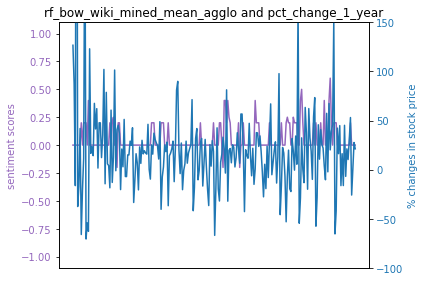

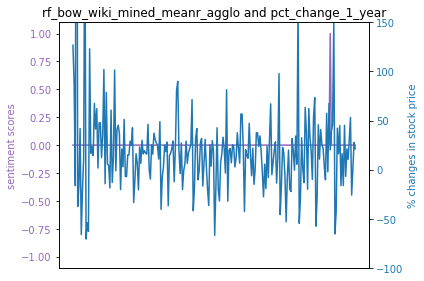

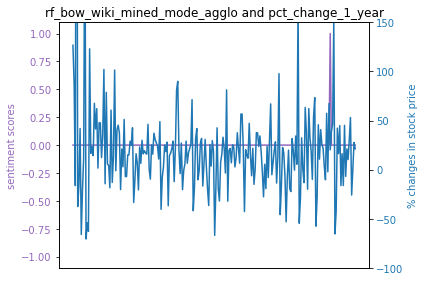

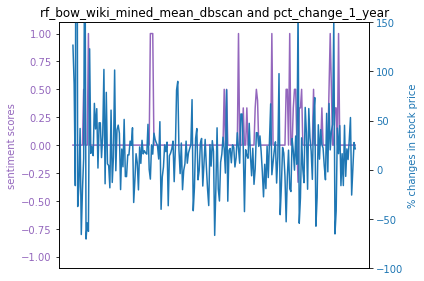

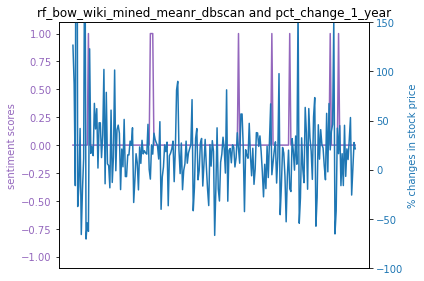

...

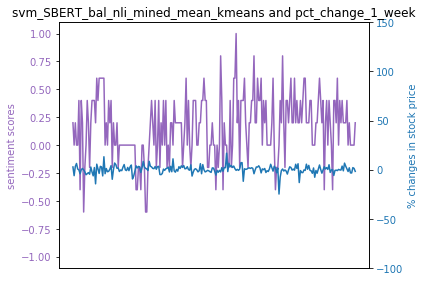

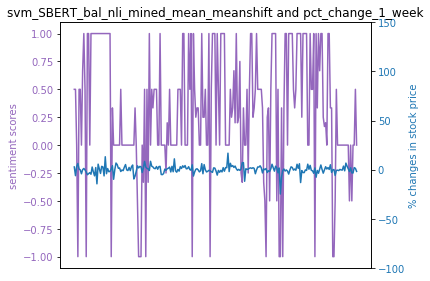

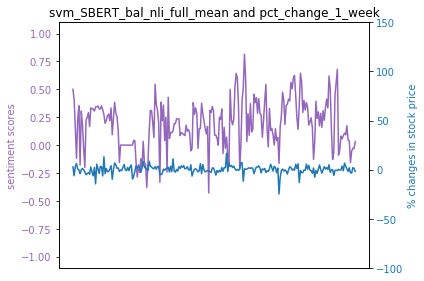

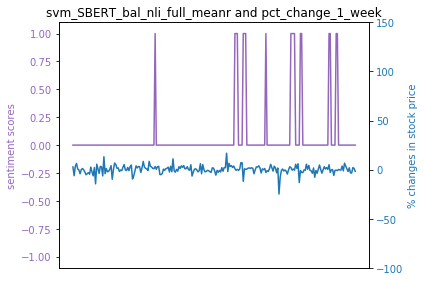

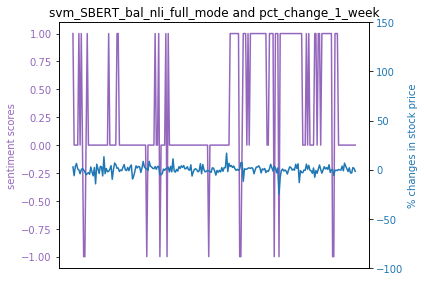

In [84]:
for date in dates_list:
    for sentiment in all_sentiments_list:
        plot_data(sentiment, date)
        print('\n')

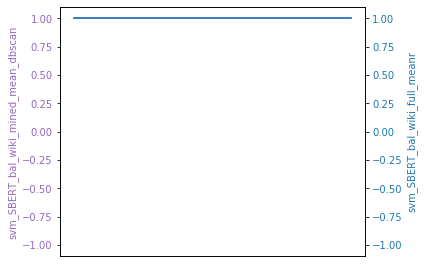

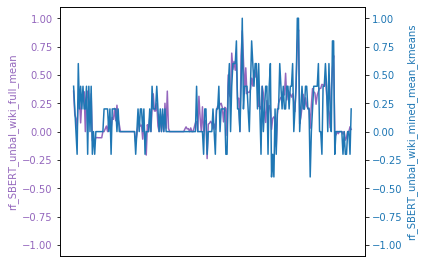

In [110]:
def plot_sentiments(sentiment1, sentiment2, score=0, cosine_x=False, pearson_x=False):
    t = new_all_data.index
    data1 = new_all_data[sentiment1]
    data2 = new_all_data[sentiment2]

    fig, ax1 = plt.subplots()

    color = 'tab:purple'
    if cosine_x==True:
        ax1.set_xlabel('cosine score = {}'.format(score))
    if pearson_x==True:
        ax1.set_xlabel('pearson score = {}'.format(score))
    # ax1.set_xticklabels([]) # Gets rid of the numbers but not ticks
    ax1.set_ylabel(sentiment1, color=color)
    ax1.plot(t, data1, color=color)
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_ylim(-1.1, 1.1)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel(sentiment2, color=color)  # we already handled the x-label with ax1
    ax2.plot(t, data2, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.set_ylim(-1.1, 1.1)


    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.xticks([]) # Gets rid of numbers and ticks
#     plt.title('{} and {}'.format(sentiment1, sentiment2))
    plt.show()

plot_sentiments('svm_SBERT_bal_wiki_mined_mean_dbscan', 'svm_SBERT_bal_wiki_full_meanr')
plot_sentiments('rf_SBERT_unbal_wiki_full_mean', 'rf_SBERT_unbal_wiki_mined_mean_kmeans')

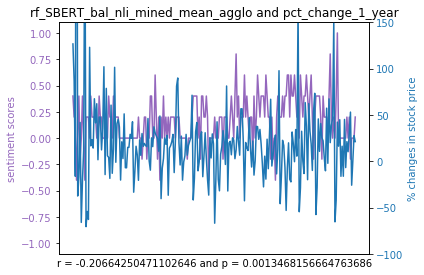

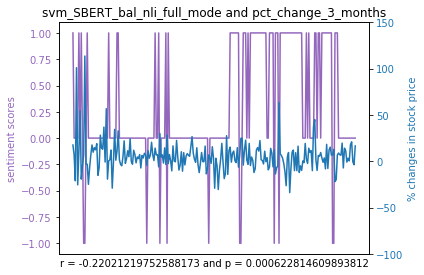

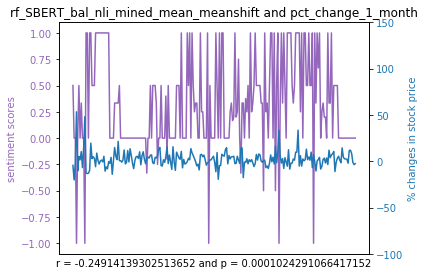

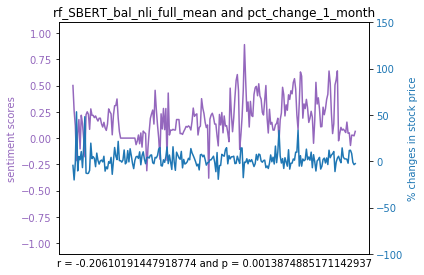

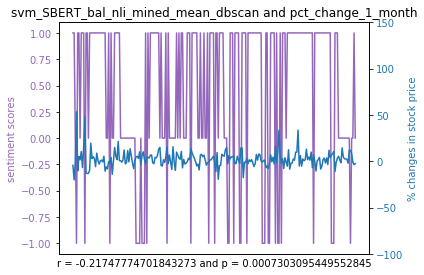

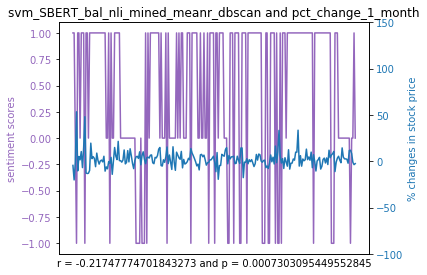

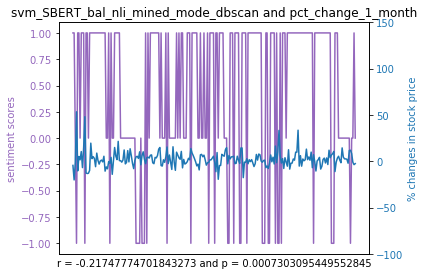

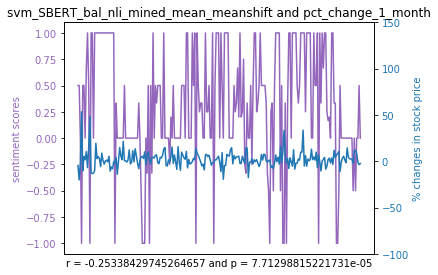

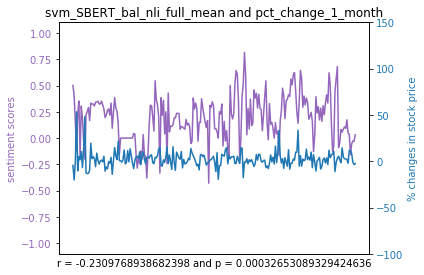

In [133]:
for pairing in large_correlation:
    plot_data(pairing[0], pairing[1], pairing[2], pairing[3], x_axis=True)

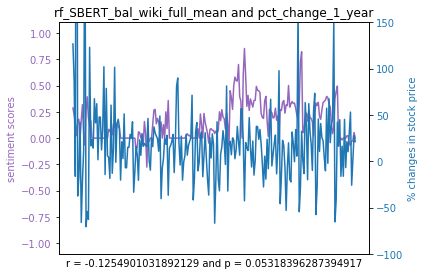

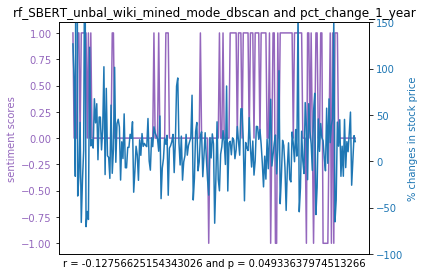

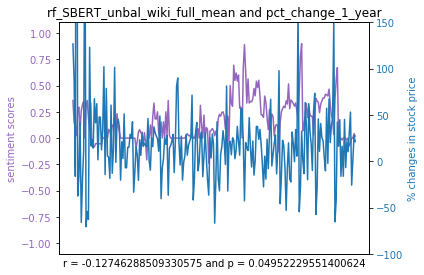

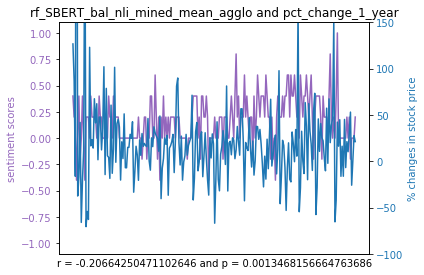

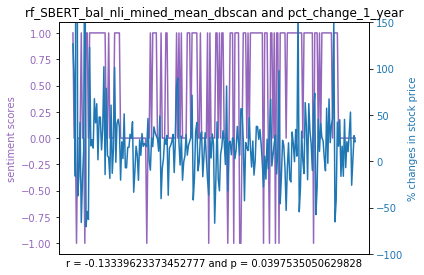

...

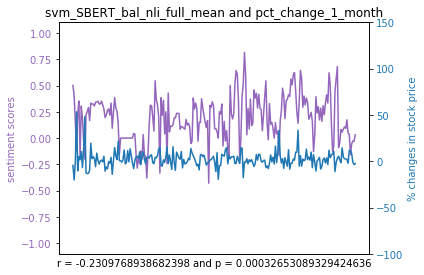

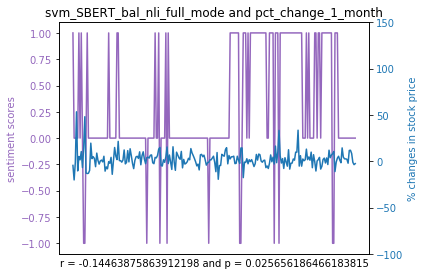

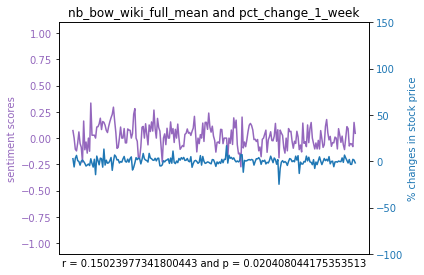

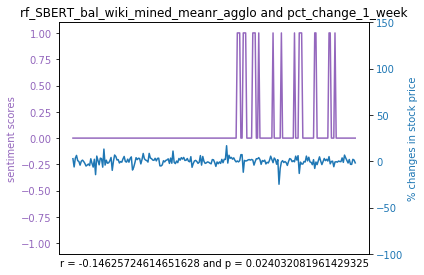

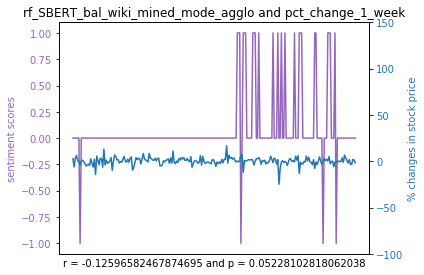

In [134]:
for pairing in statistical_significant_correlations:
    plot_data(pairing[0], pairing[1], pairing[2], pairing[3], x_axis=True)

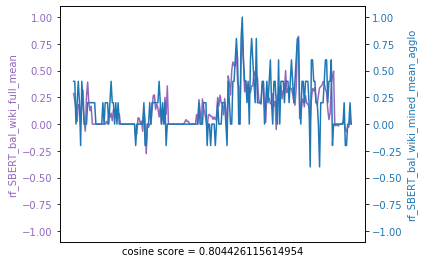

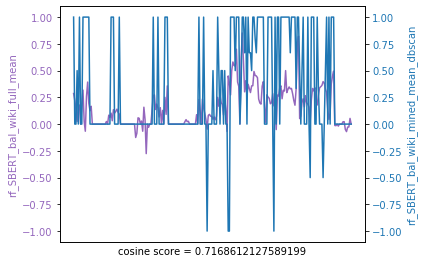

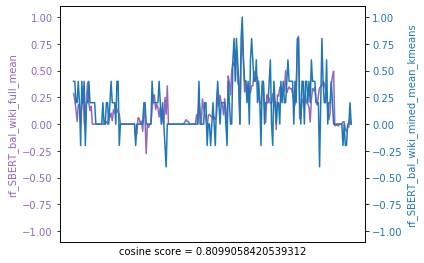

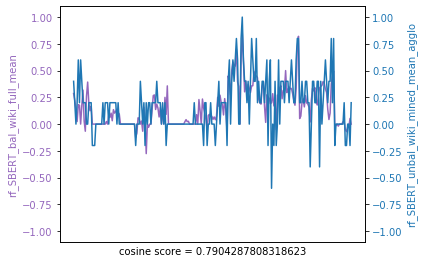

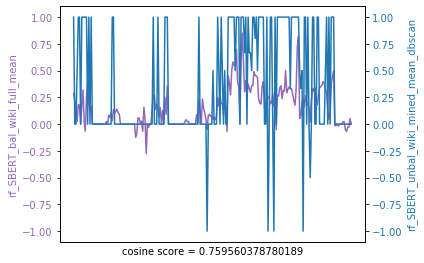

...

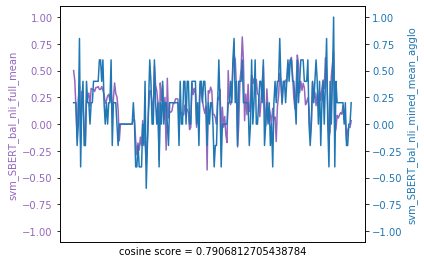

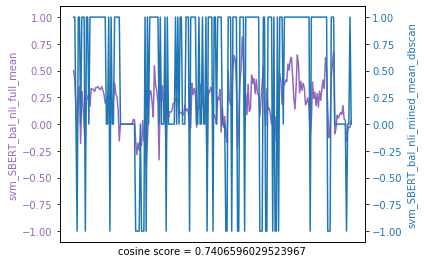

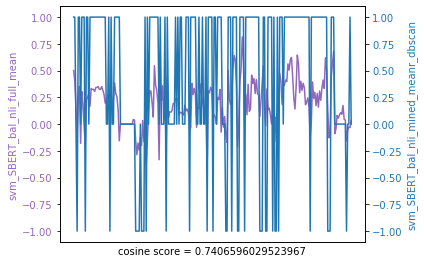

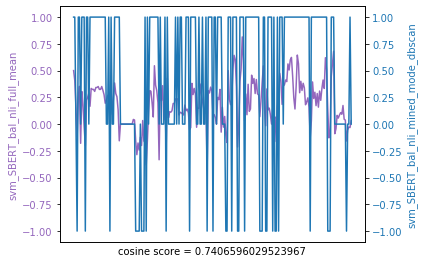

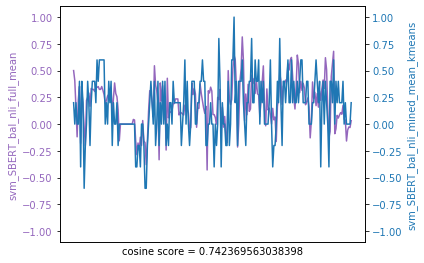

In [138]:
for pairing in full_and_mined_sentiment_cosines:
    plot_sentiments(pairing[0], pairing[1], pairing[2], cosine_x=True, pearson_x=False)

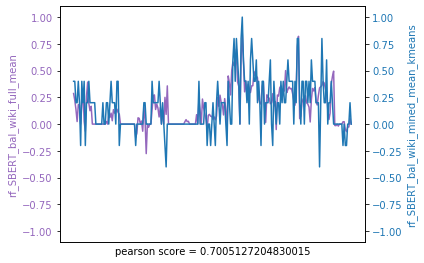

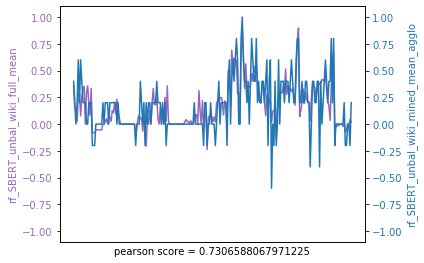

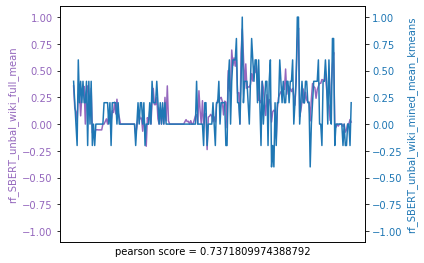

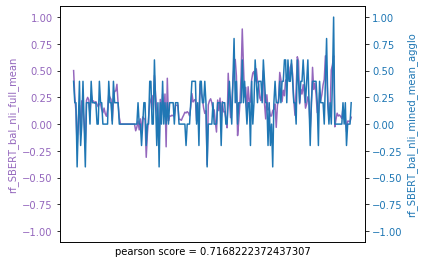

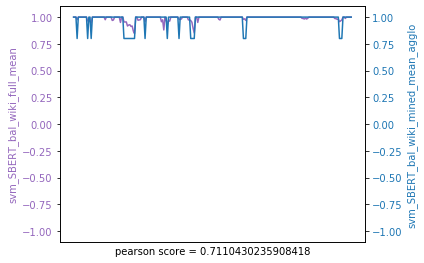

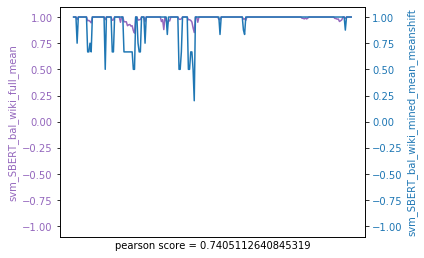

In [143]:
for pairing in full_and_mined_sentiment_pearsons:
    plot_sentiments(pairing[0], pairing[1], pairing[2], cosine_x=False, pearson_x=True)

In [165]:
with open('./models_and_dataframes/all_sentiments_list.pkl', 'wb') as f:
    pickle.dump(all_sentiments_list, f)
    
with open('./models_and_dataframes/mined_sentiments_list.pkl', 'wb') as f:
    pickle.dump(mined_sentiments_list, f)
    
with open('./models_and_dataframes/full_sentiments_list.pkl', 'wb') as f:
    pickle.dump(full_sentiments_list, f)    
    
with open('./models_and_dataframes/dates_list.pkl', 'wb') as f:
    pickle.dump(dates_list, f)    
    
with open('./models_and_dataframes/large_correlation.pkl', 'wb') as f:
    pickle.dump(large_correlation, f)    
    
with open('./models_and_dataframes/statistical_significant_correlations.pkl', 'wb') as f:
    pickle.dump(statistical_significant_correlations, f)    

with open('./models_and_dataframes/full_and_mined_sentiment_correlations_all.pkl', 'wb') as f:
    pickle.dump(full_and_mined_sentiment_correlations_all, f)

with open('./models_and_dataframes/full_and_mined_sentiment_cosines.pkl', 'wb') as f:
    pickle.dump(full_and_mined_sentiment_cosines, f)
    
with open('./models_and_dataframes/full_and_mined_sentiment_pearsons.pkl', 'wb') as f:
    pickle.dump(full_and_mined_sentiment_pearsons, f)

In [166]:
with open('./models_and_dataframes/all_sentiments_list.pkl', 'rb') as f:
    all_sentiments_list = pickle.load(f)

with open('./models_and_dataframes/mined_sentiments_list.pkl', 'rb') as f:
    mined_sentiments_list = pickle.load(f)
    
with open('./models_and_dataframes/full_sentiments_list.pkl', 'rb') as f:
    full_sentiments_list = pickle.load(f)
    
with open('./models_and_dataframes/dates_list.pkl', 'rb') as f:
    dates_list = pickle.load(f)
    
with open('./models_and_dataframes/large_correlation.pkl', 'rb') as f:
    large_correlation = pickle.load(f)
    
with open('./models_and_dataframes/statistical_significant_correlations.pkl', 'rb') as f:
    statistical_significant_correlations = pickle.load(f)
    
with open('./models_and_dataframes/full_and_mined_sentiment_correlations_all.pkl', 'rb') as f:
    full_and_mined_sentiment_correlations_all = pickle.load(f)
    
with open('./models_and_dataframes/full_and_mined_sentiment_cosines.pkl', 'rb') as f:
    full_and_mined_sentiment_cosines = pickle.load(f)
    
with open('./models_and_dataframes/full_and_mined_sentiment_pearsons.pkl', 'rb') as f:
    full_and_mined_sentiment_pearsons = pickle.load(f)

In [55]:
# # To-do: maybe leave x axis unlabelled as it means nothing.
# import numpy as np
# import matplotlib.pyplot as plt

# t = new_all_data.index
# data1 = new_all_data['weighted_embeddings']
# data2 = new_all_data['% change 1 year']

# fig, ax1 = plt.subplots()

# color = 'tab:purple'
# # ax1.set_xlabel('index')
# # ax1.set_xticklabels([]) # Gets rid of the numbers but not ticks
# ax1.set_ylabel('sentiment scores', color=color)
# ax1.plot(t, data1, color=color)
# ax1.tick_params(axis='y', labelcolor=color)
# ax1.set_ylim(-1, 1)

# ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

# color = 'tab:blue'
# ax2.set_ylabel('% changes in stock price', color=color)  # we already handled the x-label with ax1
# ax2.plot(t, data2, color=color)
# ax2.tick_params(axis='y', labelcolor=color)
# ax2.set_ylim(-100, 150)


# fig.tight_layout()  # otherwise the right y-label is slightly clipped
# plt.xticks([]) # Gets rid of numbers and ticks
# plt.title('string')
# plt.show()

In [56]:
# t = new_all_data.index
# data1 = new_all_data['full_unrounded_embeddings']
# data2 = new_all_data['% change 1 year']

# fig, ax1 = plt.subplots()

# color = 'tab:purple'
# # ax1.set_xlabel('index')
# # ax1.set_xticklabels([])
# plt.xticks([])
# ax1.set_ylabel('sentiment scores', color=color)
# ax1.plot(t, data1, color=color)
# ax1.tick_params(axis='y', labelcolor=color)
# ax1.set_ylim(0, 1)

# ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

# color = 'tab:blue'
# ax2.set_ylabel('% changes in stock price', color=color)  # we already handled the x-label with ax1
# ax2.plot(t, data2, color=color)
# ax2.tick_params(axis='y', labelcolor=color)
# ax2.set_ylim(-100, 150)

# fig.tight_layout()  # otherwise the right y-label is slightly clipped
# plt.show()

In [57]:
import torch
torch.cuda.is_available()

True

In [169]:
dates_list

['pct_change_1_year',
 'pct_change_3_months',
 'pct_change_6_months',
 'pct_change_1_month',
 'pct_change_1_week']

In [167]:
print(len(all_sentiments_list))
print(len(mined_sentiments_list))
print(len(full_sentiments_list))

88
64
24


In [168]:
full_sentiments_list

['rf_bow_wiki_full_mean',
 'rf_bow_wiki_full_meanr',
 'rf_bow_wiki_full_mode',
 'rf_bow_nli_full_mean',
 'rf_bow_nli_full_meanr',
 'rf_bow_nli_full_mode',
 'nb_bow_wiki_full_mean',
 'nb_bow_wiki_full_meanr',
 'nb_bow_wiki_full_mode',
 'rf_SBERT_bal_wiki_full_mean',
 'rf_SBERT_bal_wiki_full_meanr',
 'rf_SBERT_bal_wiki_full_mode',
 'rf_SBERT_unbal_wiki_full_mean',
 'rf_SBERT_unbal_wiki_full_meanr',
 'rf_SBERT_unbal_wiki_full_mode',
 'rf_SBERT_bal_nli_full_mean',
 'rf_SBERT_bal_nli_full_meanr',
 'rf_SBERT_bal_nli_full_mode',
 'svm_SBERT_bal_wiki_full_mean',
 'svm_SBERT_bal_wiki_full_meanr',
 'svm_SBERT_bal_wiki_full_mode',
 'svm_SBERT_bal_nli_full_mean',
 'svm_SBERT_bal_nli_full_meanr',
 'svm_SBERT_bal_nli_full_mode']